In [2]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torch.utils.data as data

import torchvision.transforms as transforms
import torchvision.datasets as datasets

from sklearn import metrics
from sklearn import decomposition
from sklearn import manifold
from tqdm.notebook import trange, tqdm
import matplotlib.pyplot as plt
import numpy as np

import copy
import random
import time

In [3]:
SEED = 1234

random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)
torch.backends.cudnn.deterministic = True

In [4]:
ROOT = '.data'

train_data = datasets.FashionMNIST(root=ROOT,
                            train=True,
                            download=True)

  0%|          | 0/26421880 [00:00<?, ?it/s]

Extracting .data/FashionMNIST/raw/train-images-idx3-ubyte.gz to .data/FashionMNIST/raw



  0%|          | 0/29515 [00:00<?, ?it/s]

Extracting .data/FashionMNIST/raw/train-labels-idx1-ubyte.gz to .data/FashionMNIST/raw



  0%|          | 0/4422102 [00:00<?, ?it/s]

Extracting .data/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to .data/FashionMNIST/raw



  0%|          | 0/5148 [00:00<?, ?it/s]

Extracting .data/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to .data/FashionMNIST/raw



In [5]:
mean = train_data.data.float().mean() / 255
std = train_data.data.float().std() / 255

In [6]:
print(f'Calculated mean: {mean}')
print(f'Calculated std: {std}')

Calculated mean: 0.28604060411453247
Calculated std: 0.35302427411079407


In [7]:
train_transforms = transforms.Compose([
                            transforms.RandomRotation(5, fill=(0,)),
                            transforms.RandomCrop(28, padding=2),
                            transforms.ToTensor(),
                            transforms.Normalize(mean=[mean], std=[std])
                                      ])

test_transforms = transforms.Compose([
                           transforms.ToTensor(),
                           transforms.Normalize(mean=[mean], std=[std])
                                     ])

In [8]:
train_data = datasets.FashionMNIST(root=ROOT,
                            train=True,
                            download=True,
                            transform=train_transforms)

test_data = datasets.FashionMNIST(root=ROOT,
                           train=False,
                           download=True,
                           transform=test_transforms)

In [9]:
print(f'Number of training examples: {len(train_data)}')
print(f'Number of testing examples: {len(test_data)}')

Number of training examples: 60000
Number of testing examples: 10000


In [10]:
def plot_images(images):

    n_images = len(images)

    rows = int(np.sqrt(n_images))
    cols = int(np.sqrt(n_images))

    fig = plt.figure()
    for i in range(rows*cols):
        ax = fig.add_subplot(rows, cols, i+1)
        ax.imshow(images[i].view(28, 28).cpu().numpy(), cmap='bone')
        ax.axis('off')

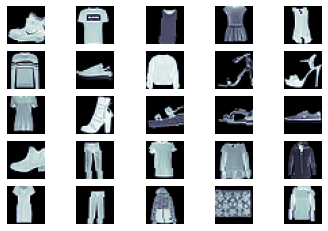

In [11]:
N_IMAGES = 25

images = [image for image, label in [train_data[i] for i in range(N_IMAGES)]]

plot_images(images)

In [12]:
VALID_RATIO = 0.9

n_train_examples = int(len(train_data) * VALID_RATIO)
n_valid_examples = len(train_data) - n_train_examples

In [13]:
temp_train_data, temp_valid_data = data.random_split(train_data, [6000, 54000])
train_data, valid_data = data.random_split(temp_train_data, [5400, 600])
# note: only 10% of the training data is selected randomly for experiments otherwise it would take large amount of time (30+ hrs) for experiments to finish. also, only 50 epochs are considered

In [14]:
print(f'Number of training examples: {len(train_data)}')
print(f'Number of validation examples: {len(valid_data)}')
print(f'Number of testing examples: {len(test_data)}')

Number of training examples: 5400
Number of validation examples: 600
Number of testing examples: 10000


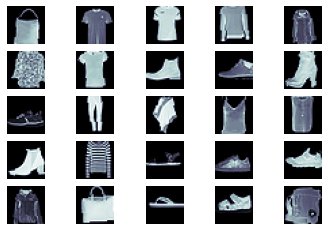

In [15]:
N_IMAGES = 25

images = [image for image, label in [valid_data[i] for i in range(N_IMAGES)]]

plot_images(images)

In [16]:
valid_data = copy.deepcopy(valid_data)
valid_data.dataset.transform = test_transforms

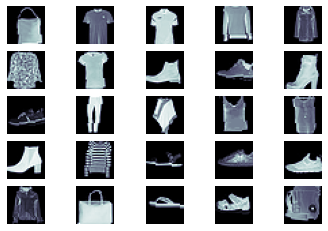

In [17]:
N_IMAGES = 25

images = [image for image, label in [valid_data[i] for i in range(N_IMAGES)]]

plot_images(images)

In [18]:
BATCH_SIZE = 64

train_iterator = data.DataLoader(train_data,
                                 shuffle=True,
                                 batch_size=BATCH_SIZE)

valid_iterator = data.DataLoader(valid_data,
                                 batch_size=BATCH_SIZE)

test_iterator = data.DataLoader(test_data,
                                batch_size=BATCH_SIZE)

In [19]:
class MLP(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()

        self.input_fc = nn.Linear(input_dim, 256)
        self.output_fc = nn.Linear(256, output_dim)

    def forward(self, x):

        # x = [batch size, height, width]

        batch_size = x.shape[0]

        x = x.view(batch_size, -1)

        # x = [batch size, height * width]

        h_1 = F.relu(self.input_fc(x))

        # h_1 = [batch size, 256]

        y_pred = self.output_fc(h_1)

        # y_pred = [batch size, output dim]

        return y_pred, h_1

class MLP2(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()

        self.input_fc = nn.Linear(input_dim, 203)
        self.hidden_fc = nn.Linear(203, 203)
        self.output_fc = nn.Linear(203, output_dim)

    def forward(self, x):

        # x = [batch size, height, width]

        batch_size = x.shape[0]

        x = x.view(batch_size, -1)

        # x = [batch size, height * width]

        h_1 = F.relu(self.input_fc(x))

        # h_1 = [batch size, 203]

        h_2 = F.relu(self.hidden_fc(h_1))

        # h_2 = [batch size, 203]

        y_pred = self.output_fc(h_2)

        # y_pred = [batch size, output dim]

        return y_pred, h_2

class MLP3(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()

        self.input_fc = nn.Linear(input_dim, 176)
        self.hidden_fc1 = nn.Linear(176, 176)
        self.hidden_fc2 = nn.Linear(176,176)
        self.output_fc = nn.Linear(176, output_dim)

    def forward(self, x):

        # x = [batch size, height, width]

        batch_size = x.shape[0]

        x = x.view(batch_size, -1)

        # x = [batch size, height * width]

        h_1 = F.relu(self.input_fc(x))

        # h_1 = [batch size, 250]

        h_2 = F.relu(self.hidden_fc1(h_1))

        # h_2 = [batch size, 100]

        h_3 = F.relu(self.hidden_fc2(h_2))

        y_pred = self.output_fc(h_3)

        # y_pred = [batch size, output dim]

        return y_pred, h_2

In [20]:
INPUT_DIM = 1* 28 * 28
OUTPUT_DIM = 10

model = MLP(INPUT_DIM, OUTPUT_DIM)
model2 = MLP2(INPUT_DIM, OUTPUT_DIM)
model3 = MLP3(INPUT_DIM, OUTPUT_DIM)

In [ ]:
class MLP(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()

        self.input_fc = nn.Linear(input_dim, 256)
        self.output_fc = nn.Linear(256, output_dim)

    def forward(self, x):

        # x = [batch size, height, width]

        batch_size = x.shape[0]

        x = x.view(batch_size, -1)

        # x = [batch size, height * width]

        h_1 = F.relu(self.input_fc(x))

        # h_1 = [batch size, 256]

        y_pred = self.output_fc(h_1)

        # y_pred = [batch size, output dim]

        return y_pred, h_1

class MLP2(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()

        self.input_fc = nn.Linear(input_dim, 203)
        self.hidden_fc = nn.Linear(203, 203)
        self.output_fc = nn.Linear(203, output_dim)

    def forward(self, x):

        # x = [batch size, height, width]

        batch_size = x.shape[0]

        x = x.view(batch_size, -1)

        # x = [batch size, height * width]

        h_1 = F.relu(self.input_fc(x))

        # h_1 = [batch size, 203]

        h_2 = F.relu(self.hidden_fc(h_1))

        # h_2 = [batch size, 203]

        y_pred = self.output_fc(h_2)

        # y_pred = [batch size, output dim]

        return y_pred, h_2

class MLP3(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()

        self.input_fc = nn.Linear(input_dim, 176)
        self.hidden_fc1 = nn.Linear(176, 176)
        self.hidden_fc2 = nn.Linear(176,176)
        self.output_fc = nn.Linear(176, output_dim)

    def forward(self, x):

        # x = [batch size, height, width]

        batch_size = x.shape[0]

        x = x.view(batch_size, -1)

        # x = [batch size, height * width]

        h_1 = F.relu(self.input_fc(x))

        # h_1 = [batch size, 250]

        h_2 = F.relu(self.hidden_fc1(h_1))

        # h_2 = [batch size, 100]

        h_3 = F.relu(self.hidden_fc2(h_2))

        y_pred = self.output_fc(h_3)

        # y_pred = [batch size, output dim]

        return y_pred, h_2
INPUT_DIM = 1* 28 * 28
OUTPUT_DIM = 10

model = MLP(INPUT_DIM, OUTPUT_DIM)
model2 = MLP2(INPUT_DIM, OUTPUT_DIM)
model3 = MLP3(INPUT_DIM, OUTPUT_DIM)

In [21]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [22]:
for i, model in enumerate([model,model2,model3]):
  print(f'The model {i+1} has {count_parameters(model):,} trainable parameters')

The model 1 has 203,530 trainable parameters
The model 2 has 202,807 trainable parameters
The model 3 has 202,234 trainable parameters


In [23]:
# optimizer = optim.SGD(model.parameters(),lr=0.01,momentum=0.9)

In [24]:
criterion = nn.CrossEntropyLoss()

In [25]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [26]:
device

device(type='cuda')

In [27]:
for model in [model,model2,model3]:
  model = model.to(device)
  criterion = criterion.to(device)

In [28]:
def calculate_accuracy(y_pred, y):
    top_pred = y_pred.argmax(1, keepdim=True)
    correct = top_pred.eq(y.view_as(top_pred)).sum()
    acc = correct.float() / y.shape[0]
    return acc

In [29]:
def train(model, iterator, optimizer, criterion, device):
    epoch_loss = 0
    epoch_acc = 0

    model.train()

    for (x, y) in tqdm(iterator, desc="Training", leave=False):

        x = x.to(device)
        y = y.to(device)

        optimizer.zero_grad()

        y_pred, _ = model(x)

        loss = criterion(y_pred, y)

        acc = calculate_accuracy(y_pred, y)

        loss.backward()

        optimizer.step()

        epoch_loss += loss.item()
        epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [30]:
def evaluate(model, iterator, criterion, device):

    epoch_loss = 0
    epoch_acc = 0

    model.eval()

    with torch.no_grad():

        for (x, y) in tqdm(iterator, desc="Evaluating", leave=False):

            x = x.to(device)
            y = y.to(device)

            y_pred, _ = model(x)

            loss = criterion(y_pred, y)

            acc = calculate_accuracy(y_pred, y)

            epoch_loss += loss.item()
            epoch_acc += acc.item()

    return epoch_loss / len(iterator), epoch_acc / len(iterator)

In [31]:
def epoch_time(start_time, end_time):
    elapsed_time = end_time - start_time
    elapsed_mins = int(elapsed_time / 60)
    elapsed_secs = int(elapsed_time - (elapsed_mins * 60))
    return elapsed_mins, elapsed_secs

In [39]:
train_losses = {}

In [41]:
for i in range(3):
  train_losses[i+1]={}
  EPOCHS = 50
  for j,lr in enumerate([0.0001,0.001,0.01,0.1,1]):
    if(i==0):
      model=MLP(INPUT_DIM, OUTPUT_DIM).to(device)
    elif(i==1):
      model=MLP2(INPUT_DIM, OUTPUT_DIM).to(device)
    else:
      model=MLP3(INPUT_DIM, OUTPUT_DIM).to(device)
    train_losses[i+1][j+1] = []
    optimizer = optim.SGD(model.parameters(),lr=lr,momentum=0.9)
    best_valid_loss = float('inf')

    for epoch in trange(EPOCHS):

        start_time = time.monotonic()

        train_loss, train_acc = train(model, train_iterator, optimizer, criterion, device)
        valid_loss, valid_acc = evaluate(model, valid_iterator, criterion, device)

        if valid_loss < best_valid_loss:
            best_valid_loss = valid_loss
            torch.save(model.state_dict(), 'tut1-model.pt')

        end_time = time.monotonic()

        epoch_mins, epoch_secs = epoch_time(start_time, end_time)
        train_losses[i+1][j+1].append(train_loss)
        print(f'Epoch: {epoch+1:03} | Epoch Time: {epoch_mins}m {epoch_secs}s')
        print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
        print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 2s
	Train Loss: 2.205 | Train Acc: 19.15%
	 Val. Loss: 2.114 |  Val. Acc: 30.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 4s
	Train Loss: 2.027 | Train Acc: 41.98%
	 Val. Loss: 1.974 |  Val. Acc: 45.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 1.872 | Train Acc: 51.10%
	 Val. Loss: 1.828 |  Val. Acc: 54.11%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 1.741 | Train Acc: 54.32%
	 Val. Loss: 1.711 |  Val. Acc: 53.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 1.622 | Train Acc: 55.36%
	 Val. Loss: 1.621 |  Val. Acc: 53.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 1.526 | Train Acc: 57.65%
	 Val. Loss: 1.540 |  Val. Acc: 55.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 1.449 | Train Acc: 58.76%
	 Val. Loss: 1.479 |  Val. Acc: 56.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 1.380 | Train Acc: 59.57%
	 Val. Loss: 1.407 |  Val. Acc: 55.94%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 1.325 | Train Acc: 60.55%
	 Val. Loss: 1.358 |  Val. Acc: 58.39%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 1.281 | Train Acc: 61.11%
	 Val. Loss: 1.320 |  Val. Acc: 57.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 2s
	Train Loss: 1.235 | Train Acc: 62.12%
	 Val. Loss: 1.282 |  Val. Acc: 59.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 1.207 | Train Acc: 61.84%
	 Val. Loss: 1.244 |  Val. Acc: 58.28%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 1.179 | Train Acc: 62.24%
	 Val. Loss: 1.235 |  Val. Acc: 58.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 2s
	Train Loss: 1.152 | Train Acc: 63.14%
	 Val. Loss: 1.198 |  Val. Acc: 59.43%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 1.128 | Train Acc: 63.22%
	 Val. Loss: 1.165 |  Val. Acc: 62.29%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 1.106 | Train Acc: 63.81%
	 Val. Loss: 1.159 |  Val. Acc: 61.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 1.088 | Train Acc: 64.07%
	 Val. Loss: 1.141 |  Val. Acc: 59.27%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 2s
	Train Loss: 1.067 | Train Acc: 64.12%
	 Val. Loss: 1.115 |  Val. Acc: 62.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 1.058 | Train Acc: 64.73%
	 Val. Loss: 1.111 |  Val. Acc: 61.51%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 1.037 | Train Acc: 64.67%
	 Val. Loss: 1.083 |  Val. Acc: 60.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 1.024 | Train Acc: 65.14%
	 Val. Loss: 1.078 |  Val. Acc: 62.81%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 2s
	Train Loss: 1.009 | Train Acc: 66.04%
	 Val. Loss: 1.056 |  Val. Acc: 64.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 1.004 | Train Acc: 65.34%
	 Val. Loss: 1.052 |  Val. Acc: 62.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.989 | Train Acc: 66.02%
	 Val. Loss: 1.052 |  Val. Acc: 62.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.973 | Train Acc: 66.58%
	 Val. Loss: 1.043 |  Val. Acc: 62.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.973 | Train Acc: 66.10%
	 Val. Loss: 1.019 |  Val. Acc: 64.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 0.951 | Train Acc: 67.08%
	 Val. Loss: 1.010 |  Val. Acc: 64.06%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.954 | Train Acc: 67.24%
	 Val. Loss: 1.000 |  Val. Acc: 64.32%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.946 | Train Acc: 67.12%
	 Val. Loss: 0.995 |  Val. Acc: 64.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.930 | Train Acc: 67.57%
	 Val. Loss: 0.982 |  Val. Acc: 67.55%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 2s
	Train Loss: 0.925 | Train Acc: 67.66%
	 Val. Loss: 0.966 |  Val. Acc: 66.72%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 2s
	Train Loss: 0.917 | Train Acc: 68.92%
	 Val. Loss: 0.985 |  Val. Acc: 65.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.909 | Train Acc: 68.50%
	 Val. Loss: 0.967 |  Val. Acc: 67.08%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.903 | Train Acc: 68.06%
	 Val. Loss: 0.964 |  Val. Acc: 65.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 2s
	Train Loss: 0.900 | Train Acc: 69.09%
	 Val. Loss: 0.943 |  Val. Acc: 67.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.897 | Train Acc: 69.14%
	 Val. Loss: 0.938 |  Val. Acc: 68.02%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.891 | Train Acc: 69.02%
	 Val. Loss: 0.928 |  Val. Acc: 66.61%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.878 | Train Acc: 69.52%
	 Val. Loss: 0.934 |  Val. Acc: 65.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.886 | Train Acc: 68.74%
	 Val. Loss: 0.942 |  Val. Acc: 67.55%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.871 | Train Acc: 69.10%
	 Val. Loss: 0.933 |  Val. Acc: 66.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 6s
	Train Loss: 0.863 | Train Acc: 69.74%
	 Val. Loss: 0.894 |  Val. Acc: 69.32%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 4s
	Train Loss: 0.863 | Train Acc: 69.75%
	 Val. Loss: 0.922 |  Val. Acc: 67.76%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.854 | Train Acc: 69.85%
	 Val. Loss: 0.926 |  Val. Acc: 66.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.850 | Train Acc: 69.65%
	 Val. Loss: 0.890 |  Val. Acc: 68.75%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.852 | Train Acc: 69.86%
	 Val. Loss: 0.906 |  Val. Acc: 67.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.851 | Train Acc: 69.29%
	 Val. Loss: 0.904 |  Val. Acc: 69.53%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.843 | Train Acc: 70.06%
	 Val. Loss: 0.912 |  Val. Acc: 67.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 4s
	Train Loss: 0.838 | Train Acc: 70.04%
	 Val. Loss: 0.904 |  Val. Acc: 66.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.835 | Train Acc: 70.46%
	 Val. Loss: 0.878 |  Val. Acc: 69.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.822 | Train Acc: 71.18%
	 Val. Loss: 0.887 |  Val. Acc: 68.96%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 4s
	Train Loss: 1.780 | Train Acc: 42.70%
	 Val. Loss: 1.378 |  Val. Acc: 59.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 2s
	Train Loss: 1.163 | Train Acc: 62.87%
	 Val. Loss: 1.107 |  Val. Acc: 64.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 0.990 | Train Acc: 66.32%
	 Val. Loss: 0.995 |  Val. Acc: 64.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 0.909 | Train Acc: 67.37%
	 Val. Loss: 0.932 |  Val. Acc: 65.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 4s
	Train Loss: 0.853 | Train Acc: 69.26%
	 Val. Loss: 0.873 |  Val. Acc: 69.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 0.815 | Train Acc: 71.47%
	 Val. Loss: 0.828 |  Val. Acc: 72.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.790 | Train Acc: 71.48%
	 Val. Loss: 0.825 |  Val. Acc: 70.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.770 | Train Acc: 71.79%
	 Val. Loss: 0.811 |  Val. Acc: 71.20%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 4s
	Train Loss: 0.760 | Train Acc: 72.18%
	 Val. Loss: 0.807 |  Val. Acc: 70.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.743 | Train Acc: 72.71%
	 Val. Loss: 0.786 |  Val. Acc: 72.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.731 | Train Acc: 72.29%
	 Val. Loss: 0.775 |  Val. Acc: 70.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.730 | Train Acc: 73.20%
	 Val. Loss: 0.761 |  Val. Acc: 73.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.715 | Train Acc: 73.96%
	 Val. Loss: 0.765 |  Val. Acc: 72.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.710 | Train Acc: 73.62%
	 Val. Loss: 0.766 |  Val. Acc: 70.94%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.698 | Train Acc: 74.39%
	 Val. Loss: 0.736 |  Val. Acc: 73.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.698 | Train Acc: 74.49%
	 Val. Loss: 0.748 |  Val. Acc: 72.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 4s
	Train Loss: 0.693 | Train Acc: 74.35%
	 Val. Loss: 0.758 |  Val. Acc: 72.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 2s
	Train Loss: 0.684 | Train Acc: 74.60%
	 Val. Loss: 0.730 |  Val. Acc: 73.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 2s
	Train Loss: 0.682 | Train Acc: 75.36%
	 Val. Loss: 0.729 |  Val. Acc: 74.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.682 | Train Acc: 74.94%
	 Val. Loss: 0.714 |  Val. Acc: 72.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.673 | Train Acc: 75.30%
	 Val. Loss: 0.711 |  Val. Acc: 72.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 4s
	Train Loss: 0.663 | Train Acc: 75.39%
	 Val. Loss: 0.736 |  Val. Acc: 72.86%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 5s
	Train Loss: 0.663 | Train Acc: 75.39%
	 Val. Loss: 0.738 |  Val. Acc: 73.33%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 6s
	Train Loss: 0.658 | Train Acc: 75.86%
	 Val. Loss: 0.695 |  Val. Acc: 74.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.655 | Train Acc: 75.81%
	 Val. Loss: 0.685 |  Val. Acc: 75.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 5s
	Train Loss: 0.667 | Train Acc: 74.75%
	 Val. Loss: 0.681 |  Val. Acc: 74.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.647 | Train Acc: 76.26%
	 Val. Loss: 0.708 |  Val. Acc: 74.11%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 2s
	Train Loss: 0.642 | Train Acc: 76.07%
	 Val. Loss: 0.688 |  Val. Acc: 74.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.630 | Train Acc: 77.10%
	 Val. Loss: 0.680 |  Val. Acc: 73.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.629 | Train Acc: 77.08%
	 Val. Loss: 0.706 |  Val. Acc: 75.16%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 2s
	Train Loss: 0.635 | Train Acc: 76.48%
	 Val. Loss: 0.687 |  Val. Acc: 72.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 2s
	Train Loss: 0.632 | Train Acc: 76.08%
	 Val. Loss: 0.657 |  Val. Acc: 75.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.629 | Train Acc: 77.07%
	 Val. Loss: 0.679 |  Val. Acc: 73.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.629 | Train Acc: 76.76%
	 Val. Loss: 0.669 |  Val. Acc: 76.82%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 2s
	Train Loss: 0.623 | Train Acc: 77.38%
	 Val. Loss: 0.678 |  Val. Acc: 75.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.613 | Train Acc: 77.77%
	 Val. Loss: 0.674 |  Val. Acc: 72.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 5s
	Train Loss: 0.612 | Train Acc: 77.63%
	 Val. Loss: 0.690 |  Val. Acc: 73.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 5s
	Train Loss: 0.621 | Train Acc: 76.70%
	 Val. Loss: 0.661 |  Val. Acc: 74.11%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.620 | Train Acc: 77.50%
	 Val. Loss: 0.668 |  Val. Acc: 75.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 5s
	Train Loss: 0.616 | Train Acc: 77.24%
	 Val. Loss: 0.657 |  Val. Acc: 74.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 5s
	Train Loss: 0.616 | Train Acc: 77.46%
	 Val. Loss: 0.678 |  Val. Acc: 75.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.608 | Train Acc: 77.66%
	 Val. Loss: 0.665 |  Val. Acc: 75.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 4s
	Train Loss: 0.597 | Train Acc: 78.36%
	 Val. Loss: 0.661 |  Val. Acc: 74.27%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.609 | Train Acc: 78.42%
	 Val. Loss: 0.641 |  Val. Acc: 77.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.593 | Train Acc: 78.98%
	 Val. Loss: 0.640 |  Val. Acc: 75.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: 0.593 | Train Acc: 77.96%
	 Val. Loss: 0.649 |  Val. Acc: 74.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.592 | Train Acc: 78.43%
	 Val. Loss: 0.631 |  Val. Acc: 75.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 2s
	Train Loss: 0.589 | Train Acc: 78.27%
	 Val. Loss: 0.653 |  Val. Acc: 75.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.582 | Train Acc: 79.07%
	 Val. Loss: 0.671 |  Val. Acc: 74.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.585 | Train Acc: 78.51%
	 Val. Loss: 0.636 |  Val. Acc: 76.77%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.115 | Train Acc: 60.09%
	 Val. Loss: 0.904 |  Val. Acc: 65.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 2s
	Train Loss: 0.790 | Train Acc: 69.53%
	 Val. Loss: 0.748 |  Val. Acc: 71.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 0.716 | Train Acc: 73.50%
	 Val. Loss: 0.748 |  Val. Acc: 71.30%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 0.687 | Train Acc: 73.80%
	 Val. Loss: 0.716 |  Val. Acc: 72.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.661 | Train Acc: 74.55%
	 Val. Loss: 0.724 |  Val. Acc: 73.12%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 0.641 | Train Acc: 75.44%
	 Val. Loss: 0.692 |  Val. Acc: 73.33%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 2s
	Train Loss: 0.617 | Train Acc: 76.48%
	 Val. Loss: 0.659 |  Val. Acc: 75.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 0.597 | Train Acc: 77.51%
	 Val. Loss: 0.703 |  Val. Acc: 72.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.582 | Train Acc: 78.24%
	 Val. Loss: 0.654 |  Val. Acc: 75.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.567 | Train Acc: 78.47%
	 Val. Loss: 0.603 |  Val. Acc: 77.76%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 2s
	Train Loss: 0.558 | Train Acc: 78.97%
	 Val. Loss: 0.607 |  Val. Acc: 77.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 0.548 | Train Acc: 79.61%
	 Val. Loss: 0.598 |  Val. Acc: 76.72%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 0.553 | Train Acc: 78.57%
	 Val. Loss: 0.622 |  Val. Acc: 76.98%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.527 | Train Acc: 79.86%
	 Val. Loss: 0.607 |  Val. Acc: 77.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 2s
	Train Loss: 0.530 | Train Acc: 80.25%
	 Val. Loss: 0.619 |  Val. Acc: 77.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 0.516 | Train Acc: 80.66%
	 Val. Loss: 0.622 |  Val. Acc: 75.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 0.509 | Train Acc: 80.99%
	 Val. Loss: 0.585 |  Val. Acc: 76.35%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 4s
	Train Loss: 0.509 | Train Acc: 80.59%
	 Val. Loss: 0.575 |  Val. Acc: 78.39%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 2s
	Train Loss: 0.495 | Train Acc: 81.10%
	 Val. Loss: 0.562 |  Val. Acc: 77.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.479 | Train Acc: 81.84%
	 Val. Loss: 0.580 |  Val. Acc: 78.33%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 0.483 | Train Acc: 81.43%
	 Val. Loss: 0.589 |  Val. Acc: 77.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.473 | Train Acc: 82.30%
	 Val. Loss: 0.590 |  Val. Acc: 78.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 0.483 | Train Acc: 82.19%
	 Val. Loss: 0.553 |  Val. Acc: 80.16%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 2s
	Train Loss: 0.465 | Train Acc: 82.51%
	 Val. Loss: 0.552 |  Val. Acc: 79.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.474 | Train Acc: 82.31%
	 Val. Loss: 0.573 |  Val. Acc: 78.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.465 | Train Acc: 82.70%
	 Val. Loss: 0.550 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 0.457 | Train Acc: 82.79%
	 Val. Loss: 0.567 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 2s
	Train Loss: 0.454 | Train Acc: 83.14%
	 Val. Loss: 0.539 |  Val. Acc: 78.07%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.434 | Train Acc: 84.55%
	 Val. Loss: 0.584 |  Val. Acc: 78.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.438 | Train Acc: 83.33%
	 Val. Loss: 0.554 |  Val. Acc: 78.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.435 | Train Acc: 83.55%
	 Val. Loss: 0.512 |  Val. Acc: 79.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 2s
	Train Loss: 0.430 | Train Acc: 83.80%
	 Val. Loss: 0.549 |  Val. Acc: 79.90%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.426 | Train Acc: 84.31%
	 Val. Loss: 0.533 |  Val. Acc: 79.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.434 | Train Acc: 83.46%
	 Val. Loss: 0.518 |  Val. Acc: 81.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.427 | Train Acc: 84.04%
	 Val. Loss: 0.545 |  Val. Acc: 80.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.422 | Train Acc: 83.90%
	 Val. Loss: 0.569 |  Val. Acc: 79.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: 0.408 | Train Acc: 85.10%
	 Val. Loss: 0.520 |  Val. Acc: 80.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.417 | Train Acc: 84.23%
	 Val. Loss: 0.530 |  Val. Acc: 79.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.400 | Train Acc: 85.18%
	 Val. Loss: 0.530 |  Val. Acc: 79.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 2s
	Train Loss: 0.406 | Train Acc: 84.93%
	 Val. Loss: 0.517 |  Val. Acc: 80.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 2s
	Train Loss: 0.405 | Train Acc: 85.45%
	 Val. Loss: 0.522 |  Val. Acc: 79.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 0.411 | Train Acc: 84.60%
	 Val. Loss: 0.579 |  Val. Acc: 78.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.396 | Train Acc: 84.70%
	 Val. Loss: 0.530 |  Val. Acc: 80.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 2s
	Train Loss: 0.403 | Train Acc: 85.25%
	 Val. Loss: 0.518 |  Val. Acc: 80.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.387 | Train Acc: 85.78%
	 Val. Loss: 0.574 |  Val. Acc: 79.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: 0.390 | Train Acc: 85.37%
	 Val. Loss: 0.531 |  Val. Acc: 80.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.390 | Train Acc: 85.22%
	 Val. Loss: 0.510 |  Val. Acc: 82.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.395 | Train Acc: 85.39%
	 Val. Loss: 0.536 |  Val. Acc: 80.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 2s
	Train Loss: 0.382 | Train Acc: 85.42%
	 Val. Loss: 0.539 |  Val. Acc: 80.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.391 | Train Acc: 85.19%
	 Val. Loss: 0.527 |  Val. Acc: 80.99%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.222 | Train Acc: 58.73%
	 Val. Loss: 1.118 |  Val. Acc: 64.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 1.014 | Train Acc: 63.71%
	 Val. Loss: 0.954 |  Val. Acc: 64.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 1.007 | Train Acc: 65.26%
	 Val. Loss: 1.096 |  Val. Acc: 65.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 1.017 | Train Acc: 65.34%
	 Val. Loss: 1.291 |  Val. Acc: 55.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 0.938 | Train Acc: 65.64%
	 Val. Loss: 1.063 |  Val. Acc: 63.12%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 1.002 | Train Acc: 63.28%
	 Val. Loss: 1.142 |  Val. Acc: 61.46%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 2s
	Train Loss: 1.005 | Train Acc: 64.95%
	 Val. Loss: 1.233 |  Val. Acc: 56.98%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 0.982 | Train Acc: 65.10%
	 Val. Loss: 1.077 |  Val. Acc: 61.56%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 2s
	Train Loss: 0.994 | Train Acc: 65.48%
	 Val. Loss: 1.016 |  Val. Acc: 67.55%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.921 | Train Acc: 67.43%
	 Val. Loss: 1.139 |  Val. Acc: 59.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 2s
	Train Loss: 0.940 | Train Acc: 66.13%
	 Val. Loss: 0.929 |  Val. Acc: 66.98%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 0.950 | Train Acc: 67.46%
	 Val. Loss: 1.054 |  Val. Acc: 64.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 0.888 | Train Acc: 69.23%
	 Val. Loss: 1.190 |  Val. Acc: 64.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.874 | Train Acc: 68.82%
	 Val. Loss: 1.015 |  Val. Acc: 64.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 2s
	Train Loss: 0.988 | Train Acc: 66.10%
	 Val. Loss: 1.127 |  Val. Acc: 65.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 1.027 | Train Acc: 65.48%
	 Val. Loss: 1.140 |  Val. Acc: 67.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 0.931 | Train Acc: 67.29%
	 Val. Loss: 1.079 |  Val. Acc: 62.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.937 | Train Acc: 66.45%
	 Val. Loss: 1.193 |  Val. Acc: 62.81%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.952 | Train Acc: 67.31%
	 Val. Loss: 1.092 |  Val. Acc: 67.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 0.991 | Train Acc: 67.72%
	 Val. Loss: 1.238 |  Val. Acc: 60.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 0.988 | Train Acc: 66.54%
	 Val. Loss: 1.154 |  Val. Acc: 66.35%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.917 | Train Acc: 68.40%
	 Val. Loss: 0.996 |  Val. Acc: 66.88%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.946 | Train Acc: 68.11%
	 Val. Loss: 1.159 |  Val. Acc: 62.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 2s
	Train Loss: 1.121 | Train Acc: 64.01%
	 Val. Loss: 1.539 |  Val. Acc: 60.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 1.020 | Train Acc: 66.54%
	 Val. Loss: 1.068 |  Val. Acc: 66.82%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.989 | Train Acc: 66.25%
	 Val. Loss: 1.194 |  Val. Acc: 59.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.992 | Train Acc: 68.02%
	 Val. Loss: 1.162 |  Val. Acc: 67.76%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 2s
	Train Loss: 1.000 | Train Acc: 66.16%
	 Val. Loss: 1.036 |  Val. Acc: 66.61%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.960 | Train Acc: 67.41%
	 Val. Loss: 1.216 |  Val. Acc: 66.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.940 | Train Acc: 68.20%
	 Val. Loss: 1.096 |  Val. Acc: 65.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 1.074 | Train Acc: 64.69%
	 Val. Loss: 1.369 |  Val. Acc: 61.51%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 2s
	Train Loss: 1.135 | Train Acc: 64.86%
	 Val. Loss: 1.109 |  Val. Acc: 66.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 2s
	Train Loss: 1.031 | Train Acc: 67.43%
	 Val. Loss: 1.231 |  Val. Acc: 63.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.993 | Train Acc: 67.83%
	 Val. Loss: 1.120 |  Val. Acc: 67.40%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.977 | Train Acc: 68.66%
	 Val. Loss: 1.369 |  Val. Acc: 65.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.999 | Train Acc: 67.27%
	 Val. Loss: 1.068 |  Val. Acc: 67.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: 0.935 | Train Acc: 69.53%
	 Val. Loss: 1.162 |  Val. Acc: 67.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.901 | Train Acc: 70.81%
	 Val. Loss: 1.262 |  Val. Acc: 62.86%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.926 | Train Acc: 69.91%
	 Val. Loss: 1.196 |  Val. Acc: 68.65%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.942 | Train Acc: 68.18%
	 Val. Loss: 1.282 |  Val. Acc: 62.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 2s
	Train Loss: 1.059 | Train Acc: 64.91%
	 Val. Loss: 1.388 |  Val. Acc: 59.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 1.121 | Train Acc: 63.02%
	 Val. Loss: 1.406 |  Val. Acc: 55.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 1.033 | Train Acc: 64.78%
	 Val. Loss: 1.144 |  Val. Acc: 65.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.961 | Train Acc: 68.58%
	 Val. Loss: 1.110 |  Val. Acc: 63.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.976 | Train Acc: 68.67%
	 Val. Loss: 1.235 |  Val. Acc: 61.51%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: 1.017 | Train Acc: 67.93%
	 Val. Loss: 1.302 |  Val. Acc: 59.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.947 | Train Acc: 68.22%
	 Val. Loss: 1.314 |  Val. Acc: 58.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.969 | Train Acc: 66.86%
	 Val. Loss: 1.439 |  Val. Acc: 58.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 2s
	Train Loss: 1.060 | Train Acc: 65.51%
	 Val. Loss: 1.227 |  Val. Acc: 65.62%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.983 | Train Acc: 64.49%
	 Val. Loss: 1.119 |  Val. Acc: 66.61%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 11002.677 | Train Acc: 19.71%
	 Val. Loss: 30483.033 |  Val. Acc: 13.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 101675655.713 | Train Acc: 18.30%
	 Val. Loss: 6468674244.950 |  Val. Acc: 20.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 14255873944.455 | Train Acc: 16.23%
	 Val. Loss: 335751269.650 |  Val. Acc: 15.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 7222413047.351 | Train Acc: 15.28%
	 Val. Loss: 8661038498.200 |  Val. Acc: 12.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 240704199549.797 | Train Acc: 12.57%
	 Val. Loss: 14797677536.000 |  Val. Acc: 12.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 4934467232329.350 | Train Acc: 13.09%
	 Val. Loss: 170341003478.400 |  Val. Acc: 15.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 3854569423999.357 | Train Acc: 13.39%
	 Val. Loss: 7944548023708.600 |  Val. Acc: 10.94%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 16132578203965.838 | Train Acc: 13.25%
	 Val. Loss: 36380103060465.047 |  Val. Acc: 15.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 1173052081390343.000 | Train Acc: 13.36%
	 Val. Loss: 10759315540864.000 |  Val. Acc: 12.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 457406806234938.750 | Train Acc: 14.26%
	 Val. Loss: 295575505202630.625 |  Val. Acc: 14.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 4865605632662251.000 | Train Acc: 15.44%
	 Val. Loss: 760525683313868.750 |  Val. Acc: 18.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 69010228055765992.000 | Train Acc: 14.77%
	 Val. Loss: 559542525655148160.000 |  Val. Acc: 15.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 6971582637711638528.000 | Train Acc: 16.76%
	 Val. Loss: 5147384496590002176.000 |  Val. Acc: 10.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 40736383081587261440.000 | Train Acc: 15.01%
	 Val. Loss: 23188462601463713792.000 |  Val. Acc: 14.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 1563910349794483372032.000 | Train Acc: 14.49%
	 Val. Loss: 1831590138076365062144.000 |  Val. Acc: 15.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 41049899961274777731072.000 | Train Acc: 16.86%
	 Val. Loss: 12340362698453793374208.000 |  Val. Acc: 12.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 21291203395612255113445376.000 | Train Acc: 14.95%
	 Val. Loss: 642920033971994414284800.000 |  Val. Acc: 15.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 3010240698339222284664832.000 | Train Acc: 13.81%
	 Val. Loss: 1776892260898823911505920.000 |  Val. Acc: 9.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 1569100866662574451589120.000 | Train Acc: 13.08%
	 Val. Loss: 217241881703594028171264.000 |  Val. Acc: 11.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 881817545278798048526336.000 | Train Acc: 11.88%
	 Val. Loss: 1775666524873504680050688.000 |  Val. Acc: 13.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 19020505972872204016156672.000 | Train Acc: 12.73%
	 Val. Loss: 15268271822657624878350336.000 |  Val. Acc: 12.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 75257034674616049850122240.000 | Train Acc: 13.03%
	 Val. Loss: 167419071893428742492520448.000 |  Val. Acc: 12.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 24778901687402784748369608704.000 | Train Acc: 16.19%
	 Val. Loss: 88654439118784750993916559360.000 |  Val. Acc: 13.02%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 108605382382062183303851540480.000 | Train Acc: 14.12%
	 Val. Loss: 307184657785711276775383760896.000 |  Val. Acc: 12.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 14085890847489056585263939059712.000 | Train Acc: 15.67%
	 Val. Loss: 23842052458836594950885267734528.000 |  Val. Acc: 15.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 3239773452794556381398401957232640.000 | Train Acc: 15.87%
	 Val. Loss: 152560449389896781508232871466237952.000 |  Val. Acc: 19.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 24245925395836271866191746401566720.000 | Train Acc: 18.39%
	 Val. Loss: 2006636973845199891607354534264832.000 |  Val. Acc: 17.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 13.76%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 2s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 2s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 2.290 | Train Acc: 14.68%
	 Val. Loss: 2.281 |  Val. Acc: 14.90%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 2.254 | Train Acc: 20.69%
	 Val. Loss: 2.242 |  Val. Acc: 21.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 2.217 | Train Acc: 28.04%
	 Val. Loss: 2.214 |  Val. Acc: 26.98%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 2.178 | Train Acc: 35.37%
	 Val. Loss: 2.169 |  Val. Acc: 37.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 2.135 | Train Acc: 41.42%
	 Val. Loss: 2.129 |  Val. Acc: 38.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 2.087 | Train Acc: 43.77%
	 Val. Loss: 2.080 |  Val. Acc: 41.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 2.033 | Train Acc: 45.89%
	 Val. Loss: 2.030 |  Val. Acc: 42.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 1.978 | Train Acc: 47.32%
	 Val. Loss: 1.973 |  Val. Acc: 43.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 1.915 | Train Acc: 48.57%
	 Val. Loss: 1.913 |  Val. Acc: 44.27%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 1.854 | Train Acc: 48.92%
	 Val. Loss: 1.855 |  Val. Acc: 46.09%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 1.784 | Train Acc: 50.60%
	 Val. Loss: 1.796 |  Val. Acc: 46.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 1.718 | Train Acc: 51.09%
	 Val. Loss: 1.719 |  Val. Acc: 50.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 1.654 | Train Acc: 52.43%
	 Val. Loss: 1.663 |  Val. Acc: 50.62%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 1.590 | Train Acc: 53.38%
	 Val. Loss: 1.607 |  Val. Acc: 52.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 1.534 | Train Acc: 54.20%
	 Val. Loss: 1.558 |  Val. Acc: 50.94%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 1.482 | Train Acc: 54.94%
	 Val. Loss: 1.509 |  Val. Acc: 54.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 1.431 | Train Acc: 56.54%
	 Val. Loss: 1.449 |  Val. Acc: 56.72%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 1.385 | Train Acc: 57.14%
	 Val. Loss: 1.426 |  Val. Acc: 52.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 1.348 | Train Acc: 58.35%
	 Val. Loss: 1.396 |  Val. Acc: 55.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 1.316 | Train Acc: 58.39%
	 Val. Loss: 1.343 |  Val. Acc: 57.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 1.285 | Train Acc: 59.14%
	 Val. Loss: 1.331 |  Val. Acc: 55.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 4s
	Train Loss: 1.255 | Train Acc: 59.49%
	 Val. Loss: 1.310 |  Val. Acc: 54.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 1.229 | Train Acc: 60.03%
	 Val. Loss: 1.274 |  Val. Acc: 57.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 1.210 | Train Acc: 60.31%
	 Val. Loss: 1.260 |  Val. Acc: 57.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 1.188 | Train Acc: 60.85%
	 Val. Loss: 1.231 |  Val. Acc: 56.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 1.173 | Train Acc: 60.58%
	 Val. Loss: 1.218 |  Val. Acc: 57.08%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 1.152 | Train Acc: 62.16%
	 Val. Loss: 1.216 |  Val. Acc: 57.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 1.128 | Train Acc: 62.13%
	 Val. Loss: 1.190 |  Val. Acc: 58.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 1.119 | Train Acc: 61.92%
	 Val. Loss: 1.178 |  Val. Acc: 58.39%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 1.106 | Train Acc: 62.68%
	 Val. Loss: 1.137 |  Val. Acc: 61.61%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 1.091 | Train Acc: 62.47%
	 Val. Loss: 1.154 |  Val. Acc: 59.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 1.071 | Train Acc: 63.06%
	 Val. Loss: 1.138 |  Val. Acc: 60.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 1.065 | Train Acc: 63.60%
	 Val. Loss: 1.123 |  Val. Acc: 58.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 1.059 | Train Acc: 62.50%
	 Val. Loss: 1.117 |  Val. Acc: 57.86%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 1.041 | Train Acc: 64.10%
	 Val. Loss: 1.104 |  Val. Acc: 60.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 1.025 | Train Acc: 64.40%
	 Val. Loss: 1.084 |  Val. Acc: 59.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 1.019 | Train Acc: 64.07%
	 Val. Loss: 1.083 |  Val. Acc: 59.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 1.007 | Train Acc: 65.30%
	 Val. Loss: 1.063 |  Val. Acc: 60.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 1.001 | Train Acc: 65.30%
	 Val. Loss: 1.051 |  Val. Acc: 59.32%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.995 | Train Acc: 65.71%
	 Val. Loss: 1.031 |  Val. Acc: 64.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.987 | Train Acc: 65.50%
	 Val. Loss: 1.016 |  Val. Acc: 65.16%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.979 | Train Acc: 65.03%
	 Val. Loss: 1.032 |  Val. Acc: 64.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.968 | Train Acc: 65.59%
	 Val. Loss: 1.024 |  Val. Acc: 64.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.957 | Train Acc: 66.17%
	 Val. Loss: 1.012 |  Val. Acc: 64.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.948 | Train Acc: 66.57%
	 Val. Loss: 1.016 |  Val. Acc: 64.27%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.943 | Train Acc: 65.86%
	 Val. Loss: 1.000 |  Val. Acc: 62.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.936 | Train Acc: 67.41%
	 Val. Loss: 0.999 |  Val. Acc: 64.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.927 | Train Acc: 67.31%
	 Val. Loss: 0.994 |  Val. Acc: 64.27%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.927 | Train Acc: 67.56%
	 Val. Loss: 0.980 |  Val. Acc: 62.55%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.913 | Train Acc: 67.70%
	 Val. Loss: 0.989 |  Val. Acc: 62.97%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 2.185 | Train Acc: 29.30%
	 Val. Loss: 2.017 |  Val. Acc: 47.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 1.712 | Train Acc: 50.69%
	 Val. Loss: 1.481 |  Val. Acc: 54.27%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 1.270 | Train Acc: 57.28%
	 Val. Loss: 1.223 |  Val. Acc: 56.93%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 1.098 | Train Acc: 60.85%
	 Val. Loss: 1.114 |  Val. Acc: 56.09%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.995 | Train Acc: 64.38%
	 Val. Loss: 1.007 |  Val. Acc: 64.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.930 | Train Acc: 66.44%
	 Val. Loss: 0.944 |  Val. Acc: 65.62%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.887 | Train Acc: 67.42%
	 Val. Loss: 0.922 |  Val. Acc: 66.56%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 6s
	Train Loss: 0.835 | Train Acc: 69.10%
	 Val. Loss: 0.874 |  Val. Acc: 69.53%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.806 | Train Acc: 69.92%
	 Val. Loss: 0.846 |  Val. Acc: 68.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.804 | Train Acc: 69.94%
	 Val. Loss: 0.822 |  Val. Acc: 70.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.768 | Train Acc: 71.46%
	 Val. Loss: 0.798 |  Val. Acc: 69.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.755 | Train Acc: 72.14%
	 Val. Loss: 0.782 |  Val. Acc: 70.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.749 | Train Acc: 71.80%
	 Val. Loss: 0.781 |  Val. Acc: 70.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.739 | Train Acc: 72.09%
	 Val. Loss: 0.784 |  Val. Acc: 69.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.731 | Train Acc: 72.27%
	 Val. Loss: 0.789 |  Val. Acc: 70.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.724 | Train Acc: 72.11%
	 Val. Loss: 0.759 |  Val. Acc: 71.46%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 4s
	Train Loss: 0.707 | Train Acc: 73.66%
	 Val. Loss: 0.770 |  Val. Acc: 70.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.709 | Train Acc: 73.24%
	 Val. Loss: 0.754 |  Val. Acc: 72.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.705 | Train Acc: 73.26%
	 Val. Loss: 0.730 |  Val. Acc: 72.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.693 | Train Acc: 74.07%
	 Val. Loss: 0.729 |  Val. Acc: 72.08%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.687 | Train Acc: 74.29%
	 Val. Loss: 0.712 |  Val. Acc: 72.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.688 | Train Acc: 73.97%
	 Val. Loss: 0.737 |  Val. Acc: 72.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.678 | Train Acc: 74.26%
	 Val. Loss: 0.730 |  Val. Acc: 73.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.672 | Train Acc: 74.61%
	 Val. Loss: 0.719 |  Val. Acc: 73.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.670 | Train Acc: 75.37%
	 Val. Loss: 0.711 |  Val. Acc: 73.02%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.663 | Train Acc: 75.46%
	 Val. Loss: 0.714 |  Val. Acc: 71.61%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.658 | Train Acc: 75.75%
	 Val. Loss: 0.709 |  Val. Acc: 72.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.652 | Train Acc: 74.69%
	 Val. Loss: 0.700 |  Val. Acc: 74.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.655 | Train Acc: 75.72%
	 Val. Loss: 0.717 |  Val. Acc: 74.32%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.651 | Train Acc: 75.37%
	 Val. Loss: 0.685 |  Val. Acc: 75.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.646 | Train Acc: 76.05%
	 Val. Loss: 0.701 |  Val. Acc: 75.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.640 | Train Acc: 76.08%
	 Val. Loss: 0.711 |  Val. Acc: 73.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.635 | Train Acc: 76.12%
	 Val. Loss: 0.692 |  Val. Acc: 74.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.643 | Train Acc: 75.50%
	 Val. Loss: 0.678 |  Val. Acc: 77.08%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 4s
	Train Loss: 0.633 | Train Acc: 76.43%
	 Val. Loss: 0.686 |  Val. Acc: 73.12%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.620 | Train Acc: 77.18%
	 Val. Loss: 0.654 |  Val. Acc: 75.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.623 | Train Acc: 76.70%
	 Val. Loss: 0.683 |  Val. Acc: 73.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.631 | Train Acc: 76.13%
	 Val. Loss: 0.664 |  Val. Acc: 76.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.624 | Train Acc: 77.42%
	 Val. Loss: 0.675 |  Val. Acc: 73.80%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.610 | Train Acc: 76.94%
	 Val. Loss: 0.681 |  Val. Acc: 74.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.608 | Train Acc: 77.25%
	 Val. Loss: 0.650 |  Val. Acc: 75.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.616 | Train Acc: 76.91%
	 Val. Loss: 0.678 |  Val. Acc: 74.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.608 | Train Acc: 77.45%
	 Val. Loss: 0.652 |  Val. Acc: 75.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.608 | Train Acc: 77.06%
	 Val. Loss: 0.687 |  Val. Acc: 73.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.604 | Train Acc: 77.40%
	 Val. Loss: 0.644 |  Val. Acc: 75.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.603 | Train Acc: 78.12%
	 Val. Loss: 0.641 |  Val. Acc: 75.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.599 | Train Acc: 77.27%
	 Val. Loss: 0.638 |  Val. Acc: 76.09%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.606 | Train Acc: 77.64%
	 Val. Loss: 0.654 |  Val. Acc: 74.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.585 | Train Acc: 78.36%
	 Val. Loss: 0.688 |  Val. Acc: 73.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.596 | Train Acc: 77.76%
	 Val. Loss: 0.681 |  Val. Acc: 74.53%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 4s
	Train Loss: 1.375 | Train Acc: 49.98%
	 Val. Loss: 0.989 |  Val. Acc: 60.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.826 | Train Acc: 67.97%
	 Val. Loss: 0.799 |  Val. Acc: 68.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.746 | Train Acc: 71.27%
	 Val. Loss: 0.764 |  Val. Acc: 69.53%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.690 | Train Acc: 73.38%
	 Val. Loss: 0.698 |  Val. Acc: 74.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.682 | Train Acc: 74.14%
	 Val. Loss: 0.714 |  Val. Acc: 73.39%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 4s
	Train Loss: 0.653 | Train Acc: 75.42%
	 Val. Loss: 0.690 |  Val. Acc: 71.72%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.620 | Train Acc: 76.24%
	 Val. Loss: 0.653 |  Val. Acc: 76.15%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.598 | Train Acc: 76.75%
	 Val. Loss: 0.706 |  Val. Acc: 73.07%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 4s
	Train Loss: 0.589 | Train Acc: 77.52%
	 Val. Loss: 0.680 |  Val. Acc: 72.81%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.581 | Train Acc: 77.67%
	 Val. Loss: 0.646 |  Val. Acc: 74.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.568 | Train Acc: 77.97%
	 Val. Loss: 0.583 |  Val. Acc: 77.76%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.561 | Train Acc: 78.98%
	 Val. Loss: 0.608 |  Val. Acc: 75.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.547 | Train Acc: 79.20%
	 Val. Loss: 0.608 |  Val. Acc: 77.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.534 | Train Acc: 79.42%
	 Val. Loss: 0.582 |  Val. Acc: 77.40%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.537 | Train Acc: 79.48%
	 Val. Loss: 0.595 |  Val. Acc: 77.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.519 | Train Acc: 80.12%
	 Val. Loss: 0.678 |  Val. Acc: 72.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.503 | Train Acc: 80.86%
	 Val. Loss: 0.592 |  Val. Acc: 78.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 4s
	Train Loss: 0.499 | Train Acc: 81.36%
	 Val. Loss: 0.593 |  Val. Acc: 77.29%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 4s
	Train Loss: 0.491 | Train Acc: 81.56%
	 Val. Loss: 0.573 |  Val. Acc: 77.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 4s
	Train Loss: 0.491 | Train Acc: 81.53%
	 Val. Loss: 0.593 |  Val. Acc: 77.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 4s
	Train Loss: 0.473 | Train Acc: 82.27%
	 Val. Loss: 0.540 |  Val. Acc: 79.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.470 | Train Acc: 82.19%
	 Val. Loss: 0.596 |  Val. Acc: 78.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.470 | Train Acc: 82.42%
	 Val. Loss: 0.515 |  Val. Acc: 81.61%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.470 | Train Acc: 81.99%
	 Val. Loss: 0.568 |  Val. Acc: 77.86%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.470 | Train Acc: 81.94%
	 Val. Loss: 0.541 |  Val. Acc: 78.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.454 | Train Acc: 83.41%
	 Val. Loss: 0.564 |  Val. Acc: 78.39%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 4s
	Train Loss: 0.461 | Train Acc: 82.60%
	 Val. Loss: 0.527 |  Val. Acc: 79.90%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 4s
	Train Loss: 0.461 | Train Acc: 82.18%
	 Val. Loss: 0.583 |  Val. Acc: 79.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.446 | Train Acc: 82.87%
	 Val. Loss: 0.513 |  Val. Acc: 79.43%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.437 | Train Acc: 83.46%
	 Val. Loss: 0.559 |  Val. Acc: 79.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.422 | Train Acc: 84.12%
	 Val. Loss: 0.551 |  Val. Acc: 77.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 4s
	Train Loss: 0.418 | Train Acc: 84.58%
	 Val. Loss: 0.546 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.411 | Train Acc: 84.50%
	 Val. Loss: 0.562 |  Val. Acc: 78.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.421 | Train Acc: 84.27%
	 Val. Loss: 0.543 |  Val. Acc: 78.28%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 4s
	Train Loss: 0.412 | Train Acc: 84.34%
	 Val. Loss: 0.507 |  Val. Acc: 80.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 4s
	Train Loss: 0.399 | Train Acc: 85.21%
	 Val. Loss: 0.566 |  Val. Acc: 78.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 4s
	Train Loss: 0.406 | Train Acc: 84.71%
	 Val. Loss: 0.541 |  Val. Acc: 80.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.405 | Train Acc: 84.71%
	 Val. Loss: 0.520 |  Val. Acc: 80.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 4s
	Train Loss: 0.399 | Train Acc: 84.58%
	 Val. Loss: 0.504 |  Val. Acc: 82.08%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.398 | Train Acc: 84.79%
	 Val. Loss: 0.487 |  Val. Acc: 80.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.398 | Train Acc: 84.78%
	 Val. Loss: 0.517 |  Val. Acc: 80.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 4s
	Train Loss: 0.388 | Train Acc: 85.55%
	 Val. Loss: 0.509 |  Val. Acc: 81.20%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 4s
	Train Loss: 0.380 | Train Acc: 85.95%
	 Val. Loss: 0.484 |  Val. Acc: 81.61%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.380 | Train Acc: 85.49%
	 Val. Loss: 0.527 |  Val. Acc: 80.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.380 | Train Acc: 85.10%
	 Val. Loss: 0.536 |  Val. Acc: 79.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 4s
	Train Loss: 0.380 | Train Acc: 85.63%
	 Val. Loss: 0.510 |  Val. Acc: 80.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 4s
	Train Loss: 0.374 | Train Acc: 85.83%
	 Val. Loss: 0.570 |  Val. Acc: 78.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.368 | Train Acc: 85.92%
	 Val. Loss: 0.494 |  Val. Acc: 82.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 5s
	Train Loss: 0.369 | Train Acc: 86.43%
	 Val. Loss: 0.551 |  Val. Acc: 79.32%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 4s
	Train Loss: 0.377 | Train Acc: 86.35%
	 Val. Loss: 0.511 |  Val. Acc: 81.77%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.151 | Train Acc: 58.47%
	 Val. Loss: 0.929 |  Val. Acc: 60.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.888 | Train Acc: 66.98%
	 Val. Loss: 0.993 |  Val. Acc: 59.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.832 | Train Acc: 68.44%
	 Val. Loss: 0.858 |  Val. Acc: 66.46%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.797 | Train Acc: 69.58%
	 Val. Loss: 0.808 |  Val. Acc: 70.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.802 | Train Acc: 70.52%
	 Val. Loss: 0.867 |  Val. Acc: 62.86%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.825 | Train Acc: 68.85%
	 Val. Loss: 0.829 |  Val. Acc: 68.75%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.787 | Train Acc: 69.90%
	 Val. Loss: 0.863 |  Val. Acc: 70.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.744 | Train Acc: 71.79%
	 Val. Loss: 0.767 |  Val. Acc: 70.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.727 | Train Acc: 72.44%
	 Val. Loss: 0.853 |  Val. Acc: 70.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.764 | Train Acc: 71.65%
	 Val. Loss: 0.849 |  Val. Acc: 69.32%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.747 | Train Acc: 72.44%
	 Val. Loss: 0.854 |  Val. Acc: 68.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.725 | Train Acc: 72.58%
	 Val. Loss: 0.811 |  Val. Acc: 71.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.712 | Train Acc: 74.07%
	 Val. Loss: 0.877 |  Val. Acc: 65.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 4s
	Train Loss: 0.758 | Train Acc: 72.57%
	 Val. Loss: 0.869 |  Val. Acc: 68.65%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.707 | Train Acc: 73.57%
	 Val. Loss: 0.794 |  Val. Acc: 72.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.708 | Train Acc: 73.49%
	 Val. Loss: 0.765 |  Val. Acc: 72.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.731 | Train Acc: 72.94%
	 Val. Loss: 0.850 |  Val. Acc: 70.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 4s
	Train Loss: 0.704 | Train Acc: 74.12%
	 Val. Loss: 0.858 |  Val. Acc: 71.51%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.675 | Train Acc: 74.98%
	 Val. Loss: 0.874 |  Val. Acc: 70.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.725 | Train Acc: 73.81%
	 Val. Loss: 0.831 |  Val. Acc: 70.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.669 | Train Acc: 76.11%
	 Val. Loss: 0.797 |  Val. Acc: 72.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 4s
	Train Loss: 0.693 | Train Acc: 74.96%
	 Val. Loss: 0.754 |  Val. Acc: 72.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.676 | Train Acc: 75.60%
	 Val. Loss: 0.804 |  Val. Acc: 71.15%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.696 | Train Acc: 75.00%
	 Val. Loss: 0.831 |  Val. Acc: 70.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.674 | Train Acc: 75.24%
	 Val. Loss: 0.953 |  Val. Acc: 68.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.681 | Train Acc: 74.78%
	 Val. Loss: 0.829 |  Val. Acc: 70.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.689 | Train Acc: 75.49%
	 Val. Loss: 0.855 |  Val. Acc: 73.80%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.717 | Train Acc: 74.70%
	 Val. Loss: 0.836 |  Val. Acc: 73.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.756 | Train Acc: 71.72%
	 Val. Loss: 0.902 |  Val. Acc: 73.07%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.709 | Train Acc: 73.98%
	 Val. Loss: 0.845 |  Val. Acc: 72.08%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.686 | Train Acc: 73.95%
	 Val. Loss: 0.912 |  Val. Acc: 68.33%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.725 | Train Acc: 74.36%
	 Val. Loss: 0.995 |  Val. Acc: 69.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 5s
	Train Loss: 0.701 | Train Acc: 73.88%
	 Val. Loss: 0.833 |  Val. Acc: 72.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.682 | Train Acc: 74.52%
	 Val. Loss: 0.800 |  Val. Acc: 71.56%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.685 | Train Acc: 75.01%
	 Val. Loss: 0.854 |  Val. Acc: 73.65%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.694 | Train Acc: 75.15%
	 Val. Loss: 0.976 |  Val. Acc: 69.06%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 4s
	Train Loss: 0.726 | Train Acc: 74.52%
	 Val. Loss: 0.785 |  Val. Acc: 74.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.700 | Train Acc: 73.99%
	 Val. Loss: 0.846 |  Val. Acc: 70.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.685 | Train Acc: 75.70%
	 Val. Loss: 0.932 |  Val. Acc: 70.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.671 | Train Acc: 75.80%
	 Val. Loss: 0.875 |  Val. Acc: 69.11%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.687 | Train Acc: 75.81%
	 Val. Loss: 0.814 |  Val. Acc: 73.07%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.693 | Train Acc: 74.58%
	 Val. Loss: 0.728 |  Val. Acc: 75.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.652 | Train Acc: 76.24%
	 Val. Loss: 0.873 |  Val. Acc: 72.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 4s
	Train Loss: 0.703 | Train Acc: 74.13%
	 Val. Loss: 0.865 |  Val. Acc: 70.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.691 | Train Acc: 74.39%
	 Val. Loss: 0.897 |  Val. Acc: 71.20%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.666 | Train Acc: 76.27%
	 Val. Loss: 0.775 |  Val. Acc: 68.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.668 | Train Acc: 75.29%
	 Val. Loss: 0.876 |  Val. Acc: 72.81%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 4s
	Train Loss: 0.720 | Train Acc: 75.17%
	 Val. Loss: 0.914 |  Val. Acc: 74.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.694 | Train Acc: 75.37%
	 Val. Loss: 0.847 |  Val. Acc: 73.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.694 | Train Acc: 75.06%
	 Val. Loss: 0.887 |  Val. Acc: 68.85%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.70%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.10%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 2.298 | Train Acc: 15.30%
	 Val. Loss: 2.298 |  Val. Acc: 14.27%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 2.293 | Train Acc: 17.10%
	 Val. Loss: 2.293 |  Val. Acc: 15.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 2.289 | Train Acc: 18.69%
	 Val. Loss: 2.288 |  Val. Acc: 15.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 4s
	Train Loss: 2.283 | Train Acc: 20.70%
	 Val. Loss: 2.284 |  Val. Acc: 18.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 2.279 | Train Acc: 22.05%
	 Val. Loss: 2.279 |  Val. Acc: 20.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 2.273 | Train Acc: 23.08%
	 Val. Loss: 2.274 |  Val. Acc: 20.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 4s
	Train Loss: 2.267 | Train Acc: 23.82%
	 Val. Loss: 2.269 |  Val. Acc: 20.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 2.261 | Train Acc: 24.70%
	 Val. Loss: 2.262 |  Val. Acc: 22.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 2.254 | Train Acc: 24.64%
	 Val. Loss: 2.253 |  Val. Acc: 22.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 2.246 | Train Acc: 24.64%
	 Val. Loss: 2.246 |  Val. Acc: 22.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 4s
	Train Loss: 2.237 | Train Acc: 25.58%
	 Val. Loss: 2.239 |  Val. Acc: 23.65%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 2.227 | Train Acc: 26.37%
	 Val. Loss: 2.230 |  Val. Acc: 24.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 2.217 | Train Acc: 26.64%
	 Val. Loss: 2.218 |  Val. Acc: 24.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 2.204 | Train Acc: 26.70%
	 Val. Loss: 2.205 |  Val. Acc: 24.53%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 2.191 | Train Acc: 28.09%
	 Val. Loss: 2.193 |  Val. Acc: 25.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 2.177 | Train Acc: 28.40%
	 Val. Loss: 2.177 |  Val. Acc: 27.76%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 2.160 | Train Acc: 29.72%
	 Val. Loss: 2.162 |  Val. Acc: 26.88%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 4s
	Train Loss: 2.143 | Train Acc: 30.14%
	 Val. Loss: 2.145 |  Val. Acc: 28.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 2.124 | Train Acc: 30.36%
	 Val. Loss: 2.126 |  Val. Acc: 29.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 2.102 | Train Acc: 32.14%
	 Val. Loss: 2.103 |  Val. Acc: 30.63%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 2.080 | Train Acc: 33.89%
	 Val. Loss: 2.084 |  Val. Acc: 30.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 4s
	Train Loss: 2.055 | Train Acc: 34.78%
	 Val. Loss: 2.056 |  Val. Acc: 33.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 2.028 | Train Acc: 36.45%
	 Val. Loss: 2.031 |  Val. Acc: 35.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 1.998 | Train Acc: 38.85%
	 Val. Loss: 2.003 |  Val. Acc: 36.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 4s
	Train Loss: 1.968 | Train Acc: 40.58%
	 Val. Loss: 1.969 |  Val. Acc: 37.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 1.932 | Train Acc: 42.22%
	 Val. Loss: 1.934 |  Val. Acc: 40.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 1.892 | Train Acc: 44.06%
	 Val. Loss: 1.895 |  Val. Acc: 42.40%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 1.850 | Train Acc: 46.83%
	 Val. Loss: 1.857 |  Val. Acc: 41.82%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 1.805 | Train Acc: 48.03%
	 Val. Loss: 1.817 |  Val. Acc: 44.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 1.755 | Train Acc: 51.10%
	 Val. Loss: 1.762 |  Val. Acc: 48.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 1.705 | Train Acc: 52.34%
	 Val. Loss: 1.718 |  Val. Acc: 47.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 1.652 | Train Acc: 52.85%
	 Val. Loss: 1.665 |  Val. Acc: 47.86%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 1.601 | Train Acc: 52.56%
	 Val. Loss: 1.616 |  Val. Acc: 49.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 1.548 | Train Acc: 52.87%
	 Val. Loss: 1.576 |  Val. Acc: 48.80%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 1.505 | Train Acc: 52.37%
	 Val. Loss: 1.527 |  Val. Acc: 51.04%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 4s
	Train Loss: 1.460 | Train Acc: 51.73%
	 Val. Loss: 1.493 |  Val. Acc: 50.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 4s
	Train Loss: 1.424 | Train Acc: 52.44%
	 Val. Loss: 1.461 |  Val. Acc: 49.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 1.391 | Train Acc: 52.97%
	 Val. Loss: 1.433 |  Val. Acc: 50.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 1.358 | Train Acc: 52.90%
	 Val. Loss: 1.396 |  Val. Acc: 51.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 1.329 | Train Acc: 54.01%
	 Val. Loss: 1.375 |  Val. Acc: 50.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 1.303 | Train Acc: 54.19%
	 Val. Loss: 1.356 |  Val. Acc: 50.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 1.284 | Train Acc: 54.90%
	 Val. Loss: 1.329 |  Val. Acc: 50.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 1.265 | Train Acc: 54.92%
	 Val. Loss: 1.314 |  Val. Acc: 51.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 4s
	Train Loss: 1.245 | Train Acc: 55.36%
	 Val. Loss: 1.293 |  Val. Acc: 51.09%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 1.232 | Train Acc: 55.53%
	 Val. Loss: 1.282 |  Val. Acc: 51.04%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 1.219 | Train Acc: 55.65%
	 Val. Loss: 1.265 |  Val. Acc: 52.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 1.203 | Train Acc: 56.61%
	 Val. Loss: 1.257 |  Val. Acc: 52.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 1.183 | Train Acc: 57.01%
	 Val. Loss: 1.247 |  Val. Acc: 50.62%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 1.174 | Train Acc: 56.80%
	 Val. Loss: 1.240 |  Val. Acc: 52.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 1.158 | Train Acc: 57.33%
	 Val. Loss: 1.201 |  Val. Acc: 52.55%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 4s
	Train Loss: 2.289 | Train Acc: 13.74%
	 Val. Loss: 2.265 |  Val. Acc: 28.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 2.224 | Train Acc: 37.98%
	 Val. Loss: 2.174 |  Val. Acc: 40.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 2.038 | Train Acc: 38.59%
	 Val. Loss: 1.897 |  Val. Acc: 32.50%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 4s
	Train Loss: 1.670 | Train Acc: 39.71%
	 Val. Loss: 1.530 |  Val. Acc: 45.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 4s
	Train Loss: 1.347 | Train Acc: 52.27%
	 Val. Loss: 1.292 |  Val. Acc: 51.82%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 1.184 | Train Acc: 55.87%
	 Val. Loss: 1.180 |  Val. Acc: 52.55%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 1.089 | Train Acc: 58.24%
	 Val. Loss: 1.113 |  Val. Acc: 56.88%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 1.023 | Train Acc: 60.55%
	 Val. Loss: 1.043 |  Val. Acc: 60.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.976 | Train Acc: 64.05%
	 Val. Loss: 1.001 |  Val. Acc: 62.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.928 | Train Acc: 65.62%
	 Val. Loss: 0.947 |  Val. Acc: 65.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.886 | Train Acc: 67.34%
	 Val. Loss: 0.922 |  Val. Acc: 65.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.856 | Train Acc: 68.17%
	 Val. Loss: 0.899 |  Val. Acc: 67.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.827 | Train Acc: 68.55%
	 Val. Loss: 0.855 |  Val. Acc: 66.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.807 | Train Acc: 69.04%
	 Val. Loss: 0.850 |  Val. Acc: 66.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.779 | Train Acc: 70.38%
	 Val. Loss: 0.858 |  Val. Acc: 67.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.774 | Train Acc: 70.02%
	 Val. Loss: 0.821 |  Val. Acc: 68.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.762 | Train Acc: 71.01%
	 Val. Loss: 0.795 |  Val. Acc: 68.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.759 | Train Acc: 71.12%
	 Val. Loss: 0.817 |  Val. Acc: 70.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 4s
	Train Loss: 0.744 | Train Acc: 72.08%
	 Val. Loss: 0.779 |  Val. Acc: 69.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.734 | Train Acc: 71.93%
	 Val. Loss: 0.758 |  Val. Acc: 72.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.731 | Train Acc: 72.49%
	 Val. Loss: 0.785 |  Val. Acc: 70.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.715 | Train Acc: 72.85%
	 Val. Loss: 0.746 |  Val. Acc: 72.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 4s
	Train Loss: 0.713 | Train Acc: 72.13%
	 Val. Loss: 0.745 |  Val. Acc: 73.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.713 | Train Acc: 72.87%
	 Val. Loss: 0.750 |  Val. Acc: 71.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.704 | Train Acc: 73.43%
	 Val. Loss: 0.752 |  Val. Acc: 71.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.697 | Train Acc: 73.38%
	 Val. Loss: 0.744 |  Val. Acc: 73.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.688 | Train Acc: 73.70%
	 Val. Loss: 0.735 |  Val. Acc: 71.98%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.687 | Train Acc: 73.45%
	 Val. Loss: 0.738 |  Val. Acc: 71.30%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.681 | Train Acc: 74.22%
	 Val. Loss: 0.745 |  Val. Acc: 72.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 4s
	Train Loss: 0.690 | Train Acc: 73.84%
	 Val. Loss: 0.730 |  Val. Acc: 71.88%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 4s
	Train Loss: 0.675 | Train Acc: 74.20%
	 Val. Loss: 0.721 |  Val. Acc: 71.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.675 | Train Acc: 73.96%
	 Val. Loss: 0.727 |  Val. Acc: 70.94%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.664 | Train Acc: 74.69%
	 Val. Loss: 0.711 |  Val. Acc: 72.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 4s
	Train Loss: 0.658 | Train Acc: 74.64%
	 Val. Loss: 0.716 |  Val. Acc: 72.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.658 | Train Acc: 74.83%
	 Val. Loss: 0.700 |  Val. Acc: 74.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.649 | Train Acc: 75.23%
	 Val. Loss: 0.711 |  Val. Acc: 71.20%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 4s
	Train Loss: 0.647 | Train Acc: 75.28%
	 Val. Loss: 0.711 |  Val. Acc: 73.02%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.648 | Train Acc: 75.02%
	 Val. Loss: 0.695 |  Val. Acc: 73.75%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.638 | Train Acc: 75.93%
	 Val. Loss: 0.691 |  Val. Acc: 73.75%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.631 | Train Acc: 75.97%
	 Val. Loss: 0.685 |  Val. Acc: 73.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 4s
	Train Loss: 0.634 | Train Acc: 76.14%
	 Val. Loss: 0.690 |  Val. Acc: 73.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.633 | Train Acc: 75.99%
	 Val. Loss: 0.696 |  Val. Acc: 72.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.628 | Train Acc: 76.64%
	 Val. Loss: 0.678 |  Val. Acc: 72.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 4s
	Train Loss: 0.622 | Train Acc: 75.99%
	 Val. Loss: 0.656 |  Val. Acc: 74.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.624 | Train Acc: 76.30%
	 Val. Loss: 0.684 |  Val. Acc: 72.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.616 | Train Acc: 76.88%
	 Val. Loss: 0.671 |  Val. Acc: 74.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 4s
	Train Loss: 0.628 | Train Acc: 75.67%
	 Val. Loss: 0.695 |  Val. Acc: 72.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 4s
	Train Loss: 0.608 | Train Acc: 76.76%
	 Val. Loss: 0.669 |  Val. Acc: 73.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.609 | Train Acc: 76.99%
	 Val. Loss: 0.666 |  Val. Acc: 73.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 4s
	Train Loss: 0.612 | Train Acc: 77.42%
	 Val. Loss: 0.670 |  Val. Acc: 74.38%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 4s
	Train Loss: 1.728 | Train Acc: 37.57%
	 Val. Loss: 1.128 |  Val. Acc: 52.86%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.972 | Train Acc: 62.18%
	 Val. Loss: 0.893 |  Val. Acc: 65.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.790 | Train Acc: 69.67%
	 Val. Loss: 0.771 |  Val. Acc: 69.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 4s
	Train Loss: 0.732 | Train Acc: 71.35%
	 Val. Loss: 0.751 |  Val. Acc: 71.15%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 4s
	Train Loss: 0.692 | Train Acc: 73.92%
	 Val. Loss: 0.766 |  Val. Acc: 72.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.666 | Train Acc: 74.80%
	 Val. Loss: 0.693 |  Val. Acc: 73.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.656 | Train Acc: 74.88%
	 Val. Loss: 0.689 |  Val. Acc: 75.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.633 | Train Acc: 75.58%
	 Val. Loss: 0.693 |  Val. Acc: 72.29%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 4s
	Train Loss: 0.620 | Train Acc: 76.26%
	 Val. Loss: 0.658 |  Val. Acc: 74.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.595 | Train Acc: 77.10%
	 Val. Loss: 0.663 |  Val. Acc: 74.43%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.578 | Train Acc: 77.73%
	 Val. Loss: 0.709 |  Val. Acc: 74.32%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.590 | Train Acc: 76.99%
	 Val. Loss: 0.614 |  Val. Acc: 75.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.577 | Train Acc: 78.15%
	 Val. Loss: 0.627 |  Val. Acc: 75.94%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.549 | Train Acc: 78.73%
	 Val. Loss: 0.623 |  Val. Acc: 74.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.558 | Train Acc: 78.93%
	 Val. Loss: 0.646 |  Val. Acc: 75.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.531 | Train Acc: 79.44%
	 Val. Loss: 0.601 |  Val. Acc: 77.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.529 | Train Acc: 79.83%
	 Val. Loss: 0.576 |  Val. Acc: 78.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.511 | Train Acc: 80.55%
	 Val. Loss: 0.585 |  Val. Acc: 77.55%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.508 | Train Acc: 80.63%
	 Val. Loss: 0.595 |  Val. Acc: 77.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 4s
	Train Loss: 0.511 | Train Acc: 80.04%
	 Val. Loss: 0.575 |  Val. Acc: 78.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.493 | Train Acc: 81.45%
	 Val. Loss: 0.566 |  Val. Acc: 79.43%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 4s
	Train Loss: 0.489 | Train Acc: 81.43%
	 Val. Loss: 0.574 |  Val. Acc: 79.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 4s
	Train Loss: 0.494 | Train Acc: 81.48%
	 Val. Loss: 0.543 |  Val. Acc: 78.28%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.478 | Train Acc: 81.99%
	 Val. Loss: 0.559 |  Val. Acc: 78.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.475 | Train Acc: 81.76%
	 Val. Loss: 0.535 |  Val. Acc: 78.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.456 | Train Acc: 82.48%
	 Val. Loss: 0.525 |  Val. Acc: 80.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.455 | Train Acc: 82.56%
	 Val. Loss: 0.582 |  Val. Acc: 78.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.451 | Train Acc: 82.47%
	 Val. Loss: 0.553 |  Val. Acc: 78.02%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.446 | Train Acc: 82.83%
	 Val. Loss: 0.594 |  Val. Acc: 77.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.461 | Train Acc: 82.62%
	 Val. Loss: 0.565 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 4s
	Train Loss: 0.437 | Train Acc: 83.88%
	 Val. Loss: 0.577 |  Val. Acc: 77.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.439 | Train Acc: 83.30%
	 Val. Loss: 0.542 |  Val. Acc: 79.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.448 | Train Acc: 82.98%
	 Val. Loss: 0.504 |  Val. Acc: 80.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 4s
	Train Loss: 0.424 | Train Acc: 83.82%
	 Val. Loss: 0.500 |  Val. Acc: 82.55%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.422 | Train Acc: 84.15%
	 Val. Loss: 0.538 |  Val. Acc: 80.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.423 | Train Acc: 84.20%
	 Val. Loss: 0.500 |  Val. Acc: 81.61%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.426 | Train Acc: 83.90%
	 Val. Loss: 0.543 |  Val. Acc: 80.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.424 | Train Acc: 83.31%
	 Val. Loss: 0.544 |  Val. Acc: 80.62%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.405 | Train Acc: 84.47%
	 Val. Loss: 0.566 |  Val. Acc: 78.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.407 | Train Acc: 84.69%
	 Val. Loss: 0.574 |  Val. Acc: 77.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.419 | Train Acc: 84.04%
	 Val. Loss: 0.552 |  Val. Acc: 78.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.409 | Train Acc: 83.83%
	 Val. Loss: 0.550 |  Val. Acc: 79.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.404 | Train Acc: 84.62%
	 Val. Loss: 0.523 |  Val. Acc: 79.11%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.399 | Train Acc: 84.54%
	 Val. Loss: 0.541 |  Val. Acc: 78.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.386 | Train Acc: 85.08%
	 Val. Loss: 0.522 |  Val. Acc: 81.09%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 4s
	Train Loss: 0.373 | Train Acc: 85.55%
	 Val. Loss: 0.610 |  Val. Acc: 77.29%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 4s
	Train Loss: 0.380 | Train Acc: 85.50%
	 Val. Loss: 0.534 |  Val. Acc: 79.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.396 | Train Acc: 84.50%
	 Val. Loss: 0.548 |  Val. Acc: 80.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 4s
	Train Loss: 0.382 | Train Acc: 85.28%
	 Val. Loss: 0.563 |  Val. Acc: 78.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.382 | Train Acc: 85.41%
	 Val. Loss: 0.518 |  Val. Acc: 81.98%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.322 | Train Acc: 51.29%
	 Val. Loss: 0.930 |  Val. Acc: 64.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.899 | Train Acc: 65.69%
	 Val. Loss: 0.900 |  Val. Acc: 68.33%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 4s
	Train Loss: 0.830 | Train Acc: 68.79%
	 Val. Loss: 0.951 |  Val. Acc: 70.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.834 | Train Acc: 68.73%
	 Val. Loss: 0.868 |  Val. Acc: 68.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 4s
	Train Loss: 0.737 | Train Acc: 72.79%
	 Val. Loss: 0.876 |  Val. Acc: 64.53%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 4s
	Train Loss: 0.770 | Train Acc: 71.21%
	 Val. Loss: 0.895 |  Val. Acc: 68.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 4s
	Train Loss: 0.743 | Train Acc: 72.19%
	 Val. Loss: 0.814 |  Val. Acc: 70.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.709 | Train Acc: 73.39%
	 Val. Loss: 0.883 |  Val. Acc: 66.72%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 4s
	Train Loss: 0.702 | Train Acc: 73.85%
	 Val. Loss: 0.979 |  Val. Acc: 68.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 4s
	Train Loss: 0.706 | Train Acc: 73.90%
	 Val. Loss: 0.800 |  Val. Acc: 70.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.701 | Train Acc: 73.41%
	 Val. Loss: 0.726 |  Val. Acc: 74.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.671 | Train Acc: 75.12%
	 Val. Loss: 0.787 |  Val. Acc: 69.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.648 | Train Acc: 75.49%
	 Val. Loss: 0.797 |  Val. Acc: 74.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.680 | Train Acc: 75.00%
	 Val. Loss: 0.703 |  Val. Acc: 74.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.685 | Train Acc: 74.78%
	 Val. Loss: 0.739 |  Val. Acc: 72.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.692 | Train Acc: 74.52%
	 Val. Loss: 0.833 |  Val. Acc: 70.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.671 | Train Acc: 75.40%
	 Val. Loss: 0.816 |  Val. Acc: 71.56%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.641 | Train Acc: 76.78%
	 Val. Loss: 0.738 |  Val. Acc: 71.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.657 | Train Acc: 76.64%
	 Val. Loss: 0.804 |  Val. Acc: 72.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 4s
	Train Loss: 0.644 | Train Acc: 75.86%
	 Val. Loss: 0.864 |  Val. Acc: 69.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.632 | Train Acc: 76.59%
	 Val. Loss: 0.748 |  Val. Acc: 74.06%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 4s
	Train Loss: 0.633 | Train Acc: 77.76%
	 Val. Loss: 0.714 |  Val. Acc: 76.88%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 9s
	Train Loss: 0.640 | Train Acc: 76.99%
	 Val. Loss: 0.733 |  Val. Acc: 76.46%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 4s
	Train Loss: 0.624 | Train Acc: 77.26%
	 Val. Loss: 0.671 |  Val. Acc: 76.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 4s
	Train Loss: 0.613 | Train Acc: 77.49%
	 Val. Loss: 0.725 |  Val. Acc: 77.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 5s
	Train Loss: 0.647 | Train Acc: 76.57%
	 Val. Loss: 0.775 |  Val. Acc: 73.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 4s
	Train Loss: 0.626 | Train Acc: 77.16%
	 Val. Loss: 0.716 |  Val. Acc: 75.62%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 4s
	Train Loss: 0.627 | Train Acc: 77.84%
	 Val. Loss: 0.680 |  Val. Acc: 76.88%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 4s
	Train Loss: 0.593 | Train Acc: 78.63%
	 Val. Loss: 0.811 |  Val. Acc: 73.02%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.620 | Train Acc: 77.56%
	 Val. Loss: 0.687 |  Val. Acc: 76.30%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.613 | Train Acc: 78.35%
	 Val. Loss: 0.682 |  Val. Acc: 75.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 4s
	Train Loss: 0.592 | Train Acc: 79.09%
	 Val. Loss: 0.779 |  Val. Acc: 73.65%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 4s
	Train Loss: 0.622 | Train Acc: 78.21%
	 Val. Loss: 0.713 |  Val. Acc: 73.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 4s
	Train Loss: 0.624 | Train Acc: 78.12%
	 Val. Loss: 0.739 |  Val. Acc: 74.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 5s
	Train Loss: 0.639 | Train Acc: 77.30%
	 Val. Loss: 0.731 |  Val. Acc: 74.90%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 4s
	Train Loss: 0.616 | Train Acc: 77.52%
	 Val. Loss: 0.720 |  Val. Acc: 75.16%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 4s
	Train Loss: 0.625 | Train Acc: 76.96%
	 Val. Loss: 0.729 |  Val. Acc: 73.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 4s
	Train Loss: 0.640 | Train Acc: 77.73%
	 Val. Loss: 0.761 |  Val. Acc: 75.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 5s
	Train Loss: 0.649 | Train Acc: 77.11%
	 Val. Loss: 0.734 |  Val. Acc: 74.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 4s
	Train Loss: 0.618 | Train Acc: 77.87%
	 Val. Loss: 0.884 |  Val. Acc: 73.70%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.629 | Train Acc: 78.12%
	 Val. Loss: 0.708 |  Val. Acc: 74.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.616 | Train Acc: 77.66%
	 Val. Loss: 0.825 |  Val. Acc: 75.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.613 | Train Acc: 78.65%
	 Val. Loss: 0.773 |  Val. Acc: 75.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.649 | Train Acc: 76.77%
	 Val. Loss: 0.763 |  Val. Acc: 73.33%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.625 | Train Acc: 77.22%
	 Val. Loss: 0.802 |  Val. Acc: 75.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.626 | Train Acc: 77.56%
	 Val. Loss: 0.911 |  Val. Acc: 72.40%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.639 | Train Acc: 76.94%
	 Val. Loss: 0.694 |  Val. Acc: 75.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.612 | Train Acc: 78.86%
	 Val. Loss: 0.745 |  Val. Acc: 77.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.604 | Train Acc: 79.09%
	 Val. Loss: 0.820 |  Val. Acc: 75.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.620 | Train Acc: 77.54%
	 Val. Loss: 0.787 |  Val. Acc: 75.57%


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 11.59%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.10%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 5s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 6s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 6s
	Train Loss: nan | Train Acc: 9.98%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 5s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.01%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.07%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 9.94%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 4s
	Train Loss: nan | Train Acc: 10.04%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.10%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.13%
	 Val. Loss: nan |  Val. Acc: 10.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: nan | Train Acc: 10.10%
	 Val. Loss: nan |  Val. Acc: 10.36%


In [44]:
class MLP4(nn.Module):
    def __init__(self, input_dim, output_dim):
        super().__init__()

        self.input_fc = nn.Linear(input_dim, 512)
        self.output_fc = nn.Linear(512, output_dim)

    def forward(self, x):

        # x = [batch size, height, width]

        batch_size = x.shape[0]

        x = x.view(batch_size, -1)

        # x = [batch size, height * width]

        h_1 = F.relu(self.input_fc(x))

        # h_1 = [batch size, 256]

        y_pred = self.output_fc(h_1)

        # y_pred = [batch size, output dim]

        return y_pred, h_1

# train_losses[i+1]={}
EPOCHS = 50
for j,lr in enumerate([0.01]):
  model=MLP4(INPUT_DIM, OUTPUT_DIM).to(device)
  # train_losses[i+1][j+1] = []
  optimizer = optim.SGD(model.parameters(),lr=lr,momentum=0.9)
  best_valid_loss = float('inf')

  for epoch in trange(EPOCHS):

      start_time = time.monotonic()

      train_loss, train_acc = train(model, train_iterator, optimizer, criterion, device)
      valid_loss, valid_acc = evaluate(model, valid_iterator, criterion, device)

      if valid_loss < best_valid_loss:
          best_valid_loss = valid_loss
          torch.save(model.state_dict(), 'tut1-model.pt')

      end_time = time.monotonic()

      epoch_mins, epoch_secs = epoch_time(start_time, end_time)
      train_losses[i+1][j+1].append(train_loss)
      print(f'Epoch: {epoch+1:03} | Epoch Time: {epoch_mins}m {epoch_secs}s')
      print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
      print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')

  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 2s
	Train Loss: 1.083 | Train Acc: 61.15%
	 Val. Loss: 0.864 |  Val. Acc: 67.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 2s
	Train Loss: 0.760 | Train Acc: 71.15%
	 Val. Loss: 0.773 |  Val. Acc: 71.04%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 0.713 | Train Acc: 73.16%
	 Val. Loss: 0.721 |  Val. Acc: 73.12%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 0.669 | Train Acc: 74.63%
	 Val. Loss: 0.687 |  Val. Acc: 76.30%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 0.658 | Train Acc: 75.01%
	 Val. Loss: 0.689 |  Val. Acc: 75.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 0.629 | Train Acc: 76.26%
	 Val. Loss: 0.673 |  Val. Acc: 74.90%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 2s
	Train Loss: 0.606 | Train Acc: 77.22%
	 Val. Loss: 0.664 |  Val. Acc: 75.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.596 | Train Acc: 78.11%
	 Val. Loss: 0.630 |  Val. Acc: 76.09%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 2s
	Train Loss: 0.567 | Train Acc: 78.11%
	 Val. Loss: 0.621 |  Val. Acc: 76.82%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 2s
	Train Loss: 0.565 | Train Acc: 78.43%
	 Val. Loss: 0.600 |  Val. Acc: 78.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.553 | Train Acc: 78.85%
	 Val. Loss: 0.580 |  Val. Acc: 77.76%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.536 | Train Acc: 79.85%
	 Val. Loss: 0.589 |  Val. Acc: 76.56%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 0.536 | Train Acc: 79.77%
	 Val. Loss: 0.615 |  Val. Acc: 75.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 2s
	Train Loss: 0.522 | Train Acc: 80.32%
	 Val. Loss: 0.590 |  Val. Acc: 77.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 2s
	Train Loss: 0.522 | Train Acc: 80.44%
	 Val. Loss: 0.572 |  Val. Acc: 79.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.517 | Train Acc: 81.42%
	 Val. Loss: 0.534 |  Val. Acc: 80.16%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 0.489 | Train Acc: 82.78%
	 Val. Loss: 0.597 |  Val. Acc: 78.54%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 2s
	Train Loss: 0.496 | Train Acc: 81.53%
	 Val. Loss: 0.567 |  Val. Acc: 78.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 2s
	Train Loss: 0.483 | Train Acc: 82.31%
	 Val. Loss: 0.554 |  Val. Acc: 79.53%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 0.477 | Train Acc: 81.92%
	 Val. Loss: 0.562 |  Val. Acc: 79.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.469 | Train Acc: 82.25%
	 Val. Loss: 0.581 |  Val. Acc: 79.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 2s
	Train Loss: 0.464 | Train Acc: 82.28%
	 Val. Loss: 0.564 |  Val. Acc: 78.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 0.457 | Train Acc: 83.14%
	 Val. Loss: 0.559 |  Val. Acc: 77.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 2s
	Train Loss: 0.460 | Train Acc: 82.84%
	 Val. Loss: 0.556 |  Val. Acc: 79.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.447 | Train Acc: 83.28%
	 Val. Loss: 0.536 |  Val. Acc: 80.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.443 | Train Acc: 83.50%
	 Val. Loss: 0.515 |  Val. Acc: 81.46%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 0.447 | Train Acc: 83.41%
	 Val. Loss: 0.515 |  Val. Acc: 79.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 2s
	Train Loss: 0.434 | Train Acc: 84.26%
	 Val. Loss: 0.527 |  Val. Acc: 78.33%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.426 | Train Acc: 84.82%
	 Val. Loss: 0.573 |  Val. Acc: 79.43%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 6s
	Train Loss: 0.430 | Train Acc: 84.00%
	 Val. Loss: 0.529 |  Val. Acc: 79.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 4s
	Train Loss: 0.418 | Train Acc: 84.53%
	 Val. Loss: 0.507 |  Val. Acc: 81.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 4s
	Train Loss: 0.430 | Train Acc: 83.85%
	 Val. Loss: 0.566 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 2s
	Train Loss: 0.415 | Train Acc: 84.23%
	 Val. Loss: 0.537 |  Val. Acc: 80.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.424 | Train Acc: 84.62%
	 Val. Loss: 0.515 |  Val. Acc: 81.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 2s
	Train Loss: 0.414 | Train Acc: 84.17%
	 Val. Loss: 0.516 |  Val. Acc: 79.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.409 | Train Acc: 84.85%
	 Val. Loss: 0.519 |  Val. Acc: 80.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: 0.414 | Train Acc: 84.25%
	 Val. Loss: 0.491 |  Val. Acc: 80.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.388 | Train Acc: 85.67%
	 Val. Loss: 0.520 |  Val. Acc: 81.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.392 | Train Acc: 85.64%
	 Val. Loss: 0.517 |  Val. Acc: 80.78%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 2s
	Train Loss: 0.385 | Train Acc: 85.44%
	 Val. Loss: 0.514 |  Val. Acc: 79.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.397 | Train Acc: 85.01%
	 Val. Loss: 0.509 |  Val. Acc: 80.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 0.395 | Train Acc: 85.69%
	 Val. Loss: 0.492 |  Val. Acc: 81.93%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.397 | Train Acc: 85.11%
	 Val. Loss: 0.527 |  Val. Acc: 79.43%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 2s
	Train Loss: 0.395 | Train Acc: 85.15%
	 Val. Loss: 0.548 |  Val. Acc: 80.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.378 | Train Acc: 85.98%
	 Val. Loss: 0.510 |  Val. Acc: 80.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: 0.386 | Train Acc: 85.96%
	 Val. Loss: 0.533 |  Val. Acc: 80.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.379 | Train Acc: 85.96%
	 Val. Loss: 0.520 |  Val. Acc: 79.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 2s
	Train Loss: 0.382 | Train Acc: 85.27%
	 Val. Loss: 0.490 |  Val. Acc: 80.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 4s
	Train Loss: 0.373 | Train Acc: 86.32%
	 Val. Loss: 0.496 |  Val. Acc: 81.46%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.354 | Train Acc: 86.76%
	 Val. Loss: 0.503 |  Val. Acc: 79.53%


 > validation acc = 79.53% (784-512-10) \\
 > validation acc = 80.73% (784-256-10)

In [43]:
train_losses

{1: {1: [2.2049968607285444,
   2.0272632654975444,
   1.8722304905162137,
   1.740890329024371,
   1.6216064901912914,
   1.5260505199432373,
   1.44863524016212,
   1.3797191563774558,
   1.3245091845007504,
   1.2814367266262279,
   1.2354165077209474,
   1.206516024645637,
   1.1787212932811064,
   1.1522981061654933,
   1.1275083745227141,
   1.1057547309819389,
   1.0879965992534861,
   1.0665461925899282,
   1.0577481655513539,
   1.0366512992802788,
   1.0244397240526535,
   1.0092069766100715,
   1.004449809298796,
   0.9889627505751217,
   0.9730525928385118,
   0.9731627485331367,
   0.9511990049306084,
   0.9542720647419201,
   0.9462408703916213,
   0.9296707616132849,
   0.925193074871512,
   0.917072874658248,
   0.9091035870944753,
   0.9033877947751213,
   0.8998584165292628,
   0.8969970317447886,
   0.8905169802553513,
   0.8784842778654659,
   0.8863432666834663,
   0.8705805722404929,
   0.8629503123900469,
   0.8629693970960729,
   0.8542131185531616,
   0.8496847

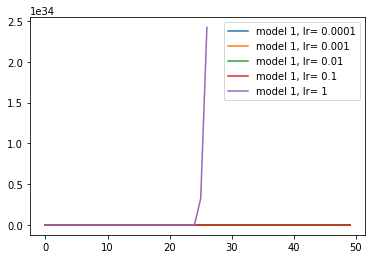

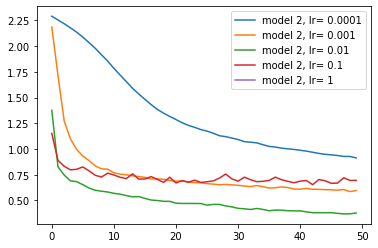

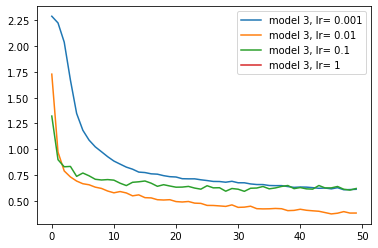

In [51]:
import matplotlib.pyplot as plt
lrs=[0.0001,0.001,0.01,0.1,1]
# plot lines
for key,val in train_losses.items():
  model_no=key
  for key2,val2 in val.items():
    try:
      lr=key2
      plt.plot(range(50), val2, label = "model "+str(model_no)+", lr= "+str(lrs[lr-1]))
    except:
      pass
  plt.legend()
  plt.show()

## a. How does increasing the learning rate affect the training loss?
Increasing the learning rate can speed up convergence but risk overshooting optimal parameter values, leading to instability and divergence. A suitable learning rate needs to balance convergence speed and stability.

## b. How does increasing the batch size affect validation accuracy?

Increasing the batch size can improve generalization performance by reducing the variance of the parameter updates and providing a better estimate of the true gradient. However, if the batch size is too large, it may lead to overfitting and poor generalization performance.

## c. How does increasing depth affect validation accuracy?

Increasing depth can improve capacity and representation power, leading to better generalization performance. However, it can also lead to overfitting, vanishing or exploding gradients, and require additional regularization or architectural modifications. The optimal depth depends on the problem and dataset.

## d. How does increasing the number of parameters affect validation accuracy?

Increasing the number of parameters can increase model capacity and representation power, potentially leading to improved validation accuracy. However, it can also increase the risk of overfitting, and require more data or regularization to prevent it. The optimal number of parameters depends on the specific problem and dataset.

In [54]:
val_accs={}
for BATCH_SIZE in [16,64,256,1024,2048]:
  val_accs[BATCH_SIZE] = {}
  # BATCH_SIZE = 64

  train_iterator = data.DataLoader(train_data,
                                  shuffle=True,
                                  batch_size=BATCH_SIZE)

  valid_iterator = data.DataLoader(valid_data,
                                  batch_size=BATCH_SIZE)

  test_iterator = data.DataLoader(test_data,
                                  batch_size=BATCH_SIZE)

  class MLP(nn.Module):
      def __init__(self, input_dim, output_dim):
          super().__init__()

          self.input_fc = nn.Linear(input_dim, 256)
          self.output_fc = nn.Linear(256, output_dim)

      def forward(self, x):

          # x = [batch size, height, width]

          batch_size = x.shape[0]

          x = x.view(batch_size, -1)

          # x = [batch size, height * width]

          h_1 = F.relu(self.input_fc(x))

          # h_1 = [batch size, 256]

          y_pred = self.output_fc(h_1)

          # y_pred = [batch size, output dim]

          return y_pred, h_1

  class MLP2(nn.Module):
      def __init__(self, input_dim, output_dim):
          super().__init__()

          self.input_fc = nn.Linear(input_dim, 203)
          self.hidden_fc = nn.Linear(203, 203)
          self.output_fc = nn.Linear(203, output_dim)

      def forward(self, x):

          # x = [batch size, height, width]

          batch_size = x.shape[0]

          x = x.view(batch_size, -1)

          # x = [batch size, height * width]

          h_1 = F.relu(self.input_fc(x))

          # h_1 = [batch size, 203]

          h_2 = F.relu(self.hidden_fc(h_1))

          # h_2 = [batch size, 203]

          y_pred = self.output_fc(h_2)

          # y_pred = [batch size, output dim]

          return y_pred, h_2

  class MLP3(nn.Module):
      def __init__(self, input_dim, output_dim):
          super().__init__()

          self.input_fc = nn.Linear(input_dim, 176)
          self.hidden_fc1 = nn.Linear(176, 176)
          self.hidden_fc2 = nn.Linear(176,176)
          self.output_fc = nn.Linear(176, output_dim)

      def forward(self, x):

          # x = [batch size, height, width]

          batch_size = x.shape[0]

          x = x.view(batch_size, -1)

          # x = [batch size, height * width]

          h_1 = F.relu(self.input_fc(x))

          # h_1 = [batch size, 250]

          h_2 = F.relu(self.hidden_fc1(h_1))

          # h_2 = [batch size, 100]

          h_3 = F.relu(self.hidden_fc2(h_2))

          y_pred = self.output_fc(h_3)

          # y_pred = [batch size, output dim]

          return y_pred, h_2
  INPUT_DIM = 1* 28 * 28
  OUTPUT_DIM = 10

  model = MLP(INPUT_DIM, OUTPUT_DIM)
  model2 = MLP2(INPUT_DIM, OUTPUT_DIM)
  model3 = MLP3(INPUT_DIM, OUTPUT_DIM)

  for i in range(3):
    train_losses[i+1]={}
    EPOCHS = 50
    for j,lr in enumerate([0.01]):
      print("MOdel=",i," lr= ",lr)
      if(i==0):
        model=MLP(INPUT_DIM, OUTPUT_DIM).to(device)
      elif(i==1):
        model=MLP2(INPUT_DIM, OUTPUT_DIM).to(device)
      else:
        model=MLP3(INPUT_DIM, OUTPUT_DIM).to(device)
      # train_losses[i+1][j+1] = []
      optimizer = optim.SGD(model.parameters(),lr=lr,momentum=0.9)
      best_valid_loss = float('inf')

      for epoch in trange(EPOCHS):

          start_time = time.monotonic()

          train_loss, train_acc = train(model, train_iterator, optimizer, criterion, device)
          valid_loss, valid_acc = evaluate(model, valid_iterator, criterion, device)

          if valid_loss < best_valid_loss:
              best_valid_loss = valid_loss
              torch.save(model.state_dict(), 'tut1-model.pt')

          end_time = time.monotonic()

          epoch_mins, epoch_secs = epoch_time(start_time, end_time)
          # train_losses[i+1][j+1].append(train_loss)
          print(f'Epoch: {epoch+1:03} | Epoch Time: {epoch_mins}m {epoch_secs}s')
          print(f'\tTrain Loss: {train_loss:.3f} | Train Acc: {train_acc*100:.2f}%')
          print(f'\t Val. Loss: {valid_loss:.3f} |  Val. Acc: {valid_acc*100:.2f}%')
      val_accs[BATCH_SIZE][i]=valid_acc

MOdel= 0  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 0.958 | Train Acc: 64.07%
	 Val. Loss: 0.916 |  Val. Acc: 64.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.746 | Train Acc: 71.15%
	 Val. Loss: 0.793 |  Val. Acc: 70.23%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 0.706 | Train Acc: 72.91%
	 Val. Loss: 0.799 |  Val. Acc: 71.71%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 0.667 | Train Acc: 74.35%
	 Val. Loss: 0.813 |  Val. Acc: 69.57%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 0.663 | Train Acc: 74.91%
	 Val. Loss: 0.778 |  Val. Acc: 73.85%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.641 | Train Acc: 75.76%
	 Val. Loss: 0.724 |  Val. Acc: 72.20%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 2s
	Train Loss: 0.620 | Train Acc: 77.29%
	 Val. Loss: 0.680 |  Val. Acc: 72.20%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 0.628 | Train Acc: 76.24%
	 Val. Loss: 0.664 |  Val. Acc: 74.67%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.590 | Train Acc: 77.88%
	 Val. Loss: 0.697 |  Val. Acc: 75.99%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.575 | Train Acc: 78.16%
	 Val. Loss: 0.688 |  Val. Acc: 75.00%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.562 | Train Acc: 78.99%
	 Val. Loss: 0.686 |  Val. Acc: 75.49%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 0.570 | Train Acc: 78.86%
	 Val. Loss: 0.714 |  Val. Acc: 74.18%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 0.562 | Train Acc: 78.88%
	 Val. Loss: 0.667 |  Val. Acc: 76.64%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.547 | Train Acc: 79.64%
	 Val. Loss: 0.633 |  Val. Acc: 74.67%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.534 | Train Acc: 80.07%
	 Val. Loss: 0.752 |  Val. Acc: 73.19%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 0.551 | Train Acc: 79.49%
	 Val. Loss: 0.611 |  Val. Acc: 76.97%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.520 | Train Acc: 80.40%
	 Val. Loss: 0.701 |  Val. Acc: 75.82%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.495 | Train Acc: 81.38%
	 Val. Loss: 0.653 |  Val. Acc: 75.66%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.530 | Train Acc: 80.07%
	 Val. Loss: 0.630 |  Val. Acc: 77.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 0.527 | Train Acc: 79.99%
	 Val. Loss: 0.645 |  Val. Acc: 77.14%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.499 | Train Acc: 80.77%
	 Val. Loss: 0.640 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.507 | Train Acc: 81.21%
	 Val. Loss: 0.675 |  Val. Acc: 76.81%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.500 | Train Acc: 81.31%
	 Val. Loss: 0.621 |  Val. Acc: 77.47%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.490 | Train Acc: 81.60%
	 Val. Loss: 0.628 |  Val. Acc: 77.14%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.484 | Train Acc: 82.08%
	 Val. Loss: 0.677 |  Val. Acc: 75.33%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.499 | Train Acc: 81.32%
	 Val. Loss: 0.591 |  Val. Acc: 77.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 0.489 | Train Acc: 82.10%
	 Val. Loss: 0.683 |  Val. Acc: 76.48%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.493 | Train Acc: 82.08%
	 Val. Loss: 0.663 |  Val. Acc: 76.64%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.503 | Train Acc: 81.40%
	 Val. Loss: 0.630 |  Val. Acc: 76.97%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.474 | Train Acc: 82.82%
	 Val. Loss: 0.641 |  Val. Acc: 78.29%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.468 | Train Acc: 82.54%
	 Val. Loss: 0.666 |  Val. Acc: 77.63%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.491 | Train Acc: 81.93%
	 Val. Loss: 0.689 |  Val. Acc: 76.48%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.460 | Train Acc: 82.54%
	 Val. Loss: 0.598 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.470 | Train Acc: 83.15%
	 Val. Loss: 0.620 |  Val. Acc: 78.29%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 2s
	Train Loss: 0.468 | Train Acc: 82.25%
	 Val. Loss: 0.573 |  Val. Acc: 79.61%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.457 | Train Acc: 83.06%
	 Val. Loss: 0.615 |  Val. Acc: 79.28%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.460 | Train Acc: 82.84%
	 Val. Loss: 0.637 |  Val. Acc: 79.44%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.460 | Train Acc: 82.78%
	 Val. Loss: 0.603 |  Val. Acc: 79.61%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.446 | Train Acc: 83.75%
	 Val. Loss: 0.574 |  Val. Acc: 80.92%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.446 | Train Acc: 83.27%
	 Val. Loss: 0.591 |  Val. Acc: 77.14%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.451 | Train Acc: 83.03%
	 Val. Loss: 0.605 |  Val. Acc: 79.28%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.429 | Train Acc: 84.17%
	 Val. Loss: 0.651 |  Val. Acc: 80.92%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.442 | Train Acc: 83.73%
	 Val. Loss: 0.651 |  Val. Acc: 78.62%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.437 | Train Acc: 83.58%
	 Val. Loss: 0.743 |  Val. Acc: 78.45%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.447 | Train Acc: 83.49%
	 Val. Loss: 0.646 |  Val. Acc: 80.76%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.440 | Train Acc: 83.41%
	 Val. Loss: 0.653 |  Val. Acc: 78.45%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.446 | Train Acc: 83.27%
	 Val. Loss: 0.650 |  Val. Acc: 78.62%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.440 | Train Acc: 83.52%
	 Val. Loss: 0.644 |  Val. Acc: 77.96%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.436 | Train Acc: 83.60%
	 Val. Loss: 0.652 |  Val. Acc: 79.61%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.428 | Train Acc: 84.25%
	 Val. Loss: 0.642 |  Val. Acc: 79.93%
MOdel= 1  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.034 | Train Acc: 61.17%
	 Val. Loss: 0.810 |  Val. Acc: 68.75%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.755 | Train Acc: 71.43%
	 Val. Loss: 0.745 |  Val. Acc: 72.70%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.707 | Train Acc: 72.26%
	 Val. Loss: 0.732 |  Val. Acc: 71.88%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.657 | Train Acc: 74.91%
	 Val. Loss: 0.738 |  Val. Acc: 71.71%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.645 | Train Acc: 75.65%
	 Val. Loss: 0.697 |  Val. Acc: 73.68%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.613 | Train Acc: 76.42%
	 Val. Loss: 0.678 |  Val. Acc: 72.86%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.599 | Train Acc: 76.72%
	 Val. Loss: 0.652 |  Val. Acc: 77.14%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.583 | Train Acc: 78.35%
	 Val. Loss: 0.655 |  Val. Acc: 75.33%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.576 | Train Acc: 77.46%
	 Val. Loss: 0.628 |  Val. Acc: 77.14%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.561 | Train Acc: 78.20%
	 Val. Loss: 0.610 |  Val. Acc: 79.11%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.537 | Train Acc: 79.81%
	 Val. Loss: 0.660 |  Val. Acc: 74.34%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.529 | Train Acc: 79.40%
	 Val. Loss: 0.671 |  Val. Acc: 76.15%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.518 | Train Acc: 80.51%
	 Val. Loss: 0.617 |  Val. Acc: 76.64%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.515 | Train Acc: 80.62%
	 Val. Loss: 0.622 |  Val. Acc: 75.33%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.502 | Train Acc: 81.03%
	 Val. Loss: 0.600 |  Val. Acc: 79.77%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.494 | Train Acc: 81.58%
	 Val. Loss: 0.612 |  Val. Acc: 76.64%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.499 | Train Acc: 80.97%
	 Val. Loss: 0.612 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.487 | Train Acc: 81.36%
	 Val. Loss: 0.623 |  Val. Acc: 77.47%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.484 | Train Acc: 81.62%
	 Val. Loss: 0.617 |  Val. Acc: 77.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.457 | Train Acc: 82.67%
	 Val. Loss: 0.540 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.469 | Train Acc: 82.25%
	 Val. Loss: 0.610 |  Val. Acc: 75.66%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.468 | Train Acc: 82.47%
	 Val. Loss: 0.608 |  Val. Acc: 77.96%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.474 | Train Acc: 82.05%
	 Val. Loss: 0.616 |  Val. Acc: 77.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.457 | Train Acc: 82.45%
	 Val. Loss: 0.568 |  Val. Acc: 78.78%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.455 | Train Acc: 82.64%
	 Val. Loss: 0.562 |  Val. Acc: 79.28%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.446 | Train Acc: 82.93%
	 Val. Loss: 0.572 |  Val. Acc: 80.92%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.439 | Train Acc: 83.34%
	 Val. Loss: 0.565 |  Val. Acc: 79.11%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.441 | Train Acc: 83.14%
	 Val. Loss: 0.595 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.437 | Train Acc: 83.56%
	 Val. Loss: 0.641 |  Val. Acc: 76.64%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.432 | Train Acc: 83.41%
	 Val. Loss: 0.582 |  Val. Acc: 78.45%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.426 | Train Acc: 83.78%
	 Val. Loss: 0.552 |  Val. Acc: 79.61%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.424 | Train Acc: 83.67%
	 Val. Loss: 0.584 |  Val. Acc: 80.26%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.414 | Train Acc: 84.12%
	 Val. Loss: 0.640 |  Val. Acc: 78.62%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.424 | Train Acc: 83.86%
	 Val. Loss: 0.617 |  Val. Acc: 76.81%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.430 | Train Acc: 84.26%
	 Val. Loss: 0.602 |  Val. Acc: 77.14%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.413 | Train Acc: 84.28%
	 Val. Loss: 0.570 |  Val. Acc: 79.11%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.414 | Train Acc: 84.01%
	 Val. Loss: 0.607 |  Val. Acc: 77.96%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.409 | Train Acc: 83.82%
	 Val. Loss: 0.550 |  Val. Acc: 78.12%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.394 | Train Acc: 84.99%
	 Val. Loss: 0.578 |  Val. Acc: 76.97%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.416 | Train Acc: 84.06%
	 Val. Loss: 0.520 |  Val. Acc: 81.25%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.408 | Train Acc: 85.11%
	 Val. Loss: 0.589 |  Val. Acc: 80.10%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.385 | Train Acc: 85.21%
	 Val. Loss: 0.581 |  Val. Acc: 80.43%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.392 | Train Acc: 85.19%
	 Val. Loss: 0.681 |  Val. Acc: 77.63%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.386 | Train Acc: 85.10%
	 Val. Loss: 0.598 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.393 | Train Acc: 84.86%
	 Val. Loss: 0.552 |  Val. Acc: 79.44%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.365 | Train Acc: 86.45%
	 Val. Loss: 0.662 |  Val. Acc: 79.44%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.401 | Train Acc: 84.73%
	 Val. Loss: 0.552 |  Val. Acc: 80.10%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.380 | Train Acc: 85.78%
	 Val. Loss: 0.582 |  Val. Acc: 79.93%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.372 | Train Acc: 85.78%
	 Val. Loss: 0.606 |  Val. Acc: 80.10%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.384 | Train Acc: 85.60%
	 Val. Loss: 0.612 |  Val. Acc: 80.10%
MOdel= 2  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.175 | Train Acc: 54.25%
	 Val. Loss: 0.927 |  Val. Acc: 60.36%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.794 | Train Acc: 69.53%
	 Val. Loss: 0.827 |  Val. Acc: 66.94%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.726 | Train Acc: 71.69%
	 Val. Loss: 0.768 |  Val. Acc: 71.55%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.704 | Train Acc: 72.34%
	 Val. Loss: 0.767 |  Val. Acc: 67.93%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.653 | Train Acc: 74.17%
	 Val. Loss: 0.655 |  Val. Acc: 74.01%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.625 | Train Acc: 75.94%
	 Val. Loss: 0.693 |  Val. Acc: 75.33%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 4s
	Train Loss: 0.625 | Train Acc: 75.70%
	 Val. Loss: 0.652 |  Val. Acc: 75.00%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.600 | Train Acc: 77.11%
	 Val. Loss: 0.667 |  Val. Acc: 75.82%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.573 | Train Acc: 78.09%
	 Val. Loss: 0.694 |  Val. Acc: 75.82%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.572 | Train Acc: 77.63%
	 Val. Loss: 0.636 |  Val. Acc: 75.33%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.564 | Train Acc: 78.59%
	 Val. Loss: 0.613 |  Val. Acc: 76.97%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.554 | Train Acc: 78.18%
	 Val. Loss: 0.612 |  Val. Acc: 76.15%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.520 | Train Acc: 80.36%
	 Val. Loss: 0.560 |  Val. Acc: 79.61%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 4s
	Train Loss: 0.519 | Train Acc: 79.73%
	 Val. Loss: 0.619 |  Val. Acc: 76.81%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.509 | Train Acc: 80.51%
	 Val. Loss: 0.697 |  Val. Acc: 72.86%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.507 | Train Acc: 80.94%
	 Val. Loss: 0.655 |  Val. Acc: 76.97%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.505 | Train Acc: 81.55%
	 Val. Loss: 0.597 |  Val. Acc: 78.45%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.506 | Train Acc: 80.79%
	 Val. Loss: 0.609 |  Val. Acc: 77.14%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.491 | Train Acc: 81.18%
	 Val. Loss: 0.618 |  Val. Acc: 76.81%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.483 | Train Acc: 81.32%
	 Val. Loss: 0.644 |  Val. Acc: 75.82%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 4s
	Train Loss: 0.480 | Train Acc: 81.43%
	 Val. Loss: 0.684 |  Val. Acc: 76.81%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.487 | Train Acc: 81.56%
	 Val. Loss: 0.566 |  Val. Acc: 77.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.455 | Train Acc: 82.53%
	 Val. Loss: 0.578 |  Val. Acc: 79.77%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.461 | Train Acc: 82.56%
	 Val. Loss: 0.601 |  Val. Acc: 80.59%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 4s
	Train Loss: 0.465 | Train Acc: 82.41%
	 Val. Loss: 0.583 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.448 | Train Acc: 82.60%
	 Val. Loss: 0.608 |  Val. Acc: 77.30%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.456 | Train Acc: 82.99%
	 Val. Loss: 0.603 |  Val. Acc: 77.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 4s
	Train Loss: 0.440 | Train Acc: 83.27%
	 Val. Loss: 0.553 |  Val. Acc: 79.11%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.431 | Train Acc: 83.88%
	 Val. Loss: 0.635 |  Val. Acc: 78.29%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.441 | Train Acc: 82.93%
	 Val. Loss: 0.573 |  Val. Acc: 79.44%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.437 | Train Acc: 83.56%
	 Val. Loss: 0.590 |  Val. Acc: 77.63%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.431 | Train Acc: 83.12%
	 Val. Loss: 0.603 |  Val. Acc: 78.45%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.435 | Train Acc: 83.14%
	 Val. Loss: 0.556 |  Val. Acc: 80.26%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.419 | Train Acc: 83.69%
	 Val. Loss: 0.570 |  Val. Acc: 79.44%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 4s
	Train Loss: 0.415 | Train Acc: 84.12%
	 Val. Loss: 0.590 |  Val. Acc: 78.45%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.417 | Train Acc: 84.15%
	 Val. Loss: 0.564 |  Val. Acc: 79.93%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.413 | Train Acc: 84.73%
	 Val. Loss: 0.679 |  Val. Acc: 77.80%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.427 | Train Acc: 84.19%
	 Val. Loss: 0.517 |  Val. Acc: 80.10%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.400 | Train Acc: 84.01%
	 Val. Loss: 0.507 |  Val. Acc: 81.74%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.406 | Train Acc: 84.45%
	 Val. Loss: 0.584 |  Val. Acc: 78.29%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.408 | Train Acc: 84.54%
	 Val. Loss: 0.653 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 4s
	Train Loss: 0.406 | Train Acc: 85.04%
	 Val. Loss: 0.549 |  Val. Acc: 79.44%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.377 | Train Acc: 85.04%
	 Val. Loss: 0.562 |  Val. Acc: 79.93%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.380 | Train Acc: 85.69%
	 Val. Loss: 0.614 |  Val. Acc: 78.62%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.386 | Train Acc: 85.13%
	 Val. Loss: 0.589 |  Val. Acc: 78.62%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.389 | Train Acc: 85.19%
	 Val. Loss: 0.622 |  Val. Acc: 80.26%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.391 | Train Acc: 85.43%
	 Val. Loss: 0.581 |  Val. Acc: 78.78%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.378 | Train Acc: 85.50%
	 Val. Loss: 0.630 |  Val. Acc: 78.95%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 4s
	Train Loss: 0.376 | Train Acc: 85.60%
	 Val. Loss: 0.656 |  Val. Acc: 79.61%


Training:   0%|          | 0/338 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/38 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.376 | Train Acc: 85.65%
	 Val. Loss: 0.599 |  Val. Acc: 78.78%
MOdel= 0  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 2s
	Train Loss: 1.107 | Train Acc: 60.59%
	 Val. Loss: 0.941 |  Val. Acc: 64.06%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.778 | Train Acc: 71.00%
	 Val. Loss: 0.774 |  Val. Acc: 70.16%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.718 | Train Acc: 72.93%
	 Val. Loss: 0.733 |  Val. Acc: 71.93%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 0.675 | Train Acc: 74.48%
	 Val. Loss: 0.691 |  Val. Acc: 74.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 0.638 | Train Acc: 75.70%
	 Val. Loss: 0.637 |  Val. Acc: 76.72%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 0.625 | Train Acc: 76.19%
	 Val. Loss: 0.658 |  Val. Acc: 76.15%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.616 | Train Acc: 77.10%
	 Val. Loss: 0.654 |  Val. Acc: 74.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 0.594 | Train Acc: 78.09%
	 Val. Loss: 0.690 |  Val. Acc: 73.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 2s
	Train Loss: 0.588 | Train Acc: 77.88%
	 Val. Loss: 0.671 |  Val. Acc: 73.07%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 2s
	Train Loss: 0.577 | Train Acc: 78.14%
	 Val. Loss: 0.634 |  Val. Acc: 77.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.564 | Train Acc: 78.81%
	 Val. Loss: 0.623 |  Val. Acc: 77.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.550 | Train Acc: 79.18%
	 Val. Loss: 0.615 |  Val. Acc: 75.31%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.540 | Train Acc: 80.44%
	 Val. Loss: 0.631 |  Val. Acc: 74.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.538 | Train Acc: 79.85%
	 Val. Loss: 0.609 |  Val. Acc: 78.39%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.511 | Train Acc: 80.34%
	 Val. Loss: 0.587 |  Val. Acc: 77.81%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 0.509 | Train Acc: 80.72%
	 Val. Loss: 0.597 |  Val. Acc: 78.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 0.508 | Train Acc: 80.68%
	 Val. Loss: 0.589 |  Val. Acc: 77.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 2s
	Train Loss: 0.505 | Train Acc: 81.24%
	 Val. Loss: 0.575 |  Val. Acc: 78.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.490 | Train Acc: 82.11%
	 Val. Loss: 0.565 |  Val. Acc: 79.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.485 | Train Acc: 81.73%
	 Val. Loss: 0.553 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.480 | Train Acc: 82.13%
	 Val. Loss: 0.563 |  Val. Acc: 78.65%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.478 | Train Acc: 82.23%
	 Val. Loss: 0.588 |  Val. Acc: 78.28%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.486 | Train Acc: 81.80%
	 Val. Loss: 0.563 |  Val. Acc: 79.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.468 | Train Acc: 82.63%
	 Val. Loss: 0.559 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.461 | Train Acc: 82.90%
	 Val. Loss: 0.542 |  Val. Acc: 80.99%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.459 | Train Acc: 82.80%
	 Val. Loss: 0.560 |  Val. Acc: 80.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.468 | Train Acc: 82.41%
	 Val. Loss: 0.576 |  Val. Acc: 76.93%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.450 | Train Acc: 82.91%
	 Val. Loss: 0.550 |  Val. Acc: 77.45%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.449 | Train Acc: 83.05%
	 Val. Loss: 0.562 |  Val. Acc: 78.02%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.439 | Train Acc: 84.20%
	 Val. Loss: 0.561 |  Val. Acc: 81.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.440 | Train Acc: 83.47%
	 Val. Loss: 0.555 |  Val. Acc: 77.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.432 | Train Acc: 83.85%
	 Val. Loss: 0.558 |  Val. Acc: 78.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.433 | Train Acc: 84.38%
	 Val. Loss: 0.495 |  Val. Acc: 81.56%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.427 | Train Acc: 84.01%
	 Val. Loss: 0.550 |  Val. Acc: 78.28%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.428 | Train Acc: 84.14%
	 Val. Loss: 0.556 |  Val. Acc: 80.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.426 | Train Acc: 84.62%
	 Val. Loss: 0.557 |  Val. Acc: 80.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: 0.415 | Train Acc: 83.92%
	 Val. Loss: 0.540 |  Val. Acc: 78.65%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.423 | Train Acc: 84.50%
	 Val. Loss: 0.545 |  Val. Acc: 79.64%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.417 | Train Acc: 84.58%
	 Val. Loss: 0.521 |  Val. Acc: 81.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.408 | Train Acc: 84.88%
	 Val. Loss: 0.564 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.409 | Train Acc: 84.55%
	 Val. Loss: 0.547 |  Val. Acc: 78.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 0.410 | Train Acc: 84.83%
	 Val. Loss: 0.511 |  Val. Acc: 80.57%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.390 | Train Acc: 85.70%
	 Val. Loss: 0.563 |  Val. Acc: 78.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.409 | Train Acc: 84.85%
	 Val. Loss: 0.541 |  Val. Acc: 78.75%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.392 | Train Acc: 85.43%
	 Val. Loss: 0.512 |  Val. Acc: 80.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.386 | Train Acc: 85.36%
	 Val. Loss: 0.532 |  Val. Acc: 80.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.393 | Train Acc: 85.13%
	 Val. Loss: 0.505 |  Val. Acc: 82.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.393 | Train Acc: 85.82%
	 Val. Loss: 0.478 |  Val. Acc: 81.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.407 | Train Acc: 84.93%
	 Val. Loss: 0.513 |  Val. Acc: 81.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.381 | Train Acc: 85.91%
	 Val. Loss: 0.513 |  Val. Acc: 80.73%
MOdel= 1  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.357 | Train Acc: 52.69%
	 Val. Loss: 0.952 |  Val. Acc: 64.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.827 | Train Acc: 68.65%
	 Val. Loss: 0.812 |  Val. Acc: 67.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.754 | Train Acc: 71.26%
	 Val. Loss: 0.767 |  Val. Acc: 69.22%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.693 | Train Acc: 73.21%
	 Val. Loss: 0.707 |  Val. Acc: 73.49%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.664 | Train Acc: 74.32%
	 Val. Loss: 0.705 |  Val. Acc: 71.98%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.646 | Train Acc: 75.46%
	 Val. Loss: 0.662 |  Val. Acc: 75.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.622 | Train Acc: 76.01%
	 Val. Loss: 0.666 |  Val. Acc: 72.92%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.615 | Train Acc: 76.61%
	 Val. Loss: 0.654 |  Val. Acc: 74.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.583 | Train Acc: 78.14%
	 Val. Loss: 0.655 |  Val. Acc: 76.35%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.575 | Train Acc: 78.20%
	 Val. Loss: 0.631 |  Val. Acc: 75.47%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.556 | Train Acc: 78.96%
	 Val. Loss: 0.608 |  Val. Acc: 75.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.563 | Train Acc: 78.31%
	 Val. Loss: 0.627 |  Val. Acc: 75.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.537 | Train Acc: 79.77%
	 Val. Loss: 0.650 |  Val. Acc: 74.43%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.542 | Train Acc: 79.45%
	 Val. Loss: 0.624 |  Val. Acc: 77.34%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.515 | Train Acc: 80.88%
	 Val. Loss: 0.591 |  Val. Acc: 76.93%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.515 | Train Acc: 80.74%
	 Val. Loss: 0.599 |  Val. Acc: 76.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.507 | Train Acc: 80.94%
	 Val. Loss: 0.589 |  Val. Acc: 76.51%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.488 | Train Acc: 81.90%
	 Val. Loss: 0.588 |  Val. Acc: 77.24%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.491 | Train Acc: 82.04%
	 Val. Loss: 0.601 |  Val. Acc: 75.26%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.476 | Train Acc: 81.91%
	 Val. Loss: 0.566 |  Val. Acc: 79.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.473 | Train Acc: 81.99%
	 Val. Loss: 0.572 |  Val. Acc: 78.12%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.478 | Train Acc: 81.70%
	 Val. Loss: 0.561 |  Val. Acc: 78.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.479 | Train Acc: 81.91%
	 Val. Loss: 0.582 |  Val. Acc: 78.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.449 | Train Acc: 83.12%
	 Val. Loss: 0.540 |  Val. Acc: 79.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.457 | Train Acc: 82.92%
	 Val. Loss: 0.564 |  Val. Acc: 78.96%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.443 | Train Acc: 83.41%
	 Val. Loss: 0.538 |  Val. Acc: 79.06%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.453 | Train Acc: 82.86%
	 Val. Loss: 0.538 |  Val. Acc: 80.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.436 | Train Acc: 83.36%
	 Val. Loss: 0.541 |  Val. Acc: 80.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.431 | Train Acc: 83.98%
	 Val. Loss: 0.556 |  Val. Acc: 79.84%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.421 | Train Acc: 84.30%
	 Val. Loss: 0.526 |  Val. Acc: 81.77%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.434 | Train Acc: 83.50%
	 Val. Loss: 0.531 |  Val. Acc: 79.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.416 | Train Acc: 84.45%
	 Val. Loss: 0.571 |  Val. Acc: 78.23%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 2s
	Train Loss: 0.411 | Train Acc: 84.03%
	 Val. Loss: 0.536 |  Val. Acc: 78.28%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.417 | Train Acc: 84.28%
	 Val. Loss: 0.578 |  Val. Acc: 77.19%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.418 | Train Acc: 84.58%
	 Val. Loss: 0.583 |  Val. Acc: 78.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.408 | Train Acc: 84.73%
	 Val. Loss: 0.506 |  Val. Acc: 79.01%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.391 | Train Acc: 85.01%
	 Val. Loss: 0.545 |  Val. Acc: 78.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.402 | Train Acc: 84.93%
	 Val. Loss: 0.560 |  Val. Acc: 79.90%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.396 | Train Acc: 84.77%
	 Val. Loss: 0.556 |  Val. Acc: 77.29%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.394 | Train Acc: 84.93%
	 Val. Loss: 0.567 |  Val. Acc: 78.44%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 2s
	Train Loss: 0.394 | Train Acc: 84.72%
	 Val. Loss: 0.540 |  Val. Acc: 79.90%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.390 | Train Acc: 85.20%
	 Val. Loss: 0.537 |  Val. Acc: 78.91%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.389 | Train Acc: 85.45%
	 Val. Loss: 0.542 |  Val. Acc: 79.48%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.391 | Train Acc: 85.16%
	 Val. Loss: 0.534 |  Val. Acc: 80.05%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.401 | Train Acc: 84.86%
	 Val. Loss: 0.557 |  Val. Acc: 80.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.378 | Train Acc: 86.13%
	 Val. Loss: 0.527 |  Val. Acc: 80.73%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.382 | Train Acc: 85.55%
	 Val. Loss: 0.543 |  Val. Acc: 80.42%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 2s
	Train Loss: 0.378 | Train Acc: 86.04%
	 Val. Loss: 0.534 |  Val. Acc: 80.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.375 | Train Acc: 85.58%
	 Val. Loss: 0.533 |  Val. Acc: 79.69%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.371 | Train Acc: 86.23%
	 Val. Loss: 0.522 |  Val. Acc: 79.95%
MOdel= 2  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.741 | Train Acc: 36.36%
	 Val. Loss: 1.234 |  Val. Acc: 50.36%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.948 | Train Acc: 63.41%
	 Val. Loss: 0.860 |  Val. Acc: 64.58%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.791 | Train Acc: 69.92%
	 Val. Loss: 0.757 |  Val. Acc: 70.89%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.736 | Train Acc: 71.72%
	 Val. Loss: 0.766 |  Val. Acc: 71.98%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.693 | Train Acc: 74.17%
	 Val. Loss: 0.751 |  Val. Acc: 72.14%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.685 | Train Acc: 73.54%
	 Val. Loss: 0.710 |  Val. Acc: 71.67%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.652 | Train Acc: 75.47%
	 Val. Loss: 0.696 |  Val. Acc: 72.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.636 | Train Acc: 74.96%
	 Val. Loss: 0.692 |  Val. Acc: 74.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.613 | Train Acc: 76.42%
	 Val. Loss: 0.630 |  Val. Acc: 74.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.590 | Train Acc: 77.07%
	 Val. Loss: 0.631 |  Val. Acc: 75.52%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.589 | Train Acc: 77.39%
	 Val. Loss: 0.639 |  Val. Acc: 76.25%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.585 | Train Acc: 76.89%
	 Val. Loss: 0.712 |  Val. Acc: 72.08%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.571 | Train Acc: 77.96%
	 Val. Loss: 0.611 |  Val. Acc: 77.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.551 | Train Acc: 78.96%
	 Val. Loss: 0.622 |  Val. Acc: 77.66%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.545 | Train Acc: 78.99%
	 Val. Loss: 0.621 |  Val. Acc: 76.41%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.540 | Train Acc: 79.44%
	 Val. Loss: 0.624 |  Val. Acc: 75.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.525 | Train Acc: 80.18%
	 Val. Loss: 0.615 |  Val. Acc: 75.68%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.520 | Train Acc: 79.82%
	 Val. Loss: 0.567 |  Val. Acc: 76.35%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.507 | Train Acc: 80.22%
	 Val. Loss: 0.558 |  Val. Acc: 78.85%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.500 | Train Acc: 80.79%
	 Val. Loss: 0.605 |  Val. Acc: 77.03%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.489 | Train Acc: 81.23%
	 Val. Loss: 0.578 |  Val. Acc: 77.71%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.493 | Train Acc: 81.24%
	 Val. Loss: 0.637 |  Val. Acc: 75.94%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.491 | Train Acc: 80.73%
	 Val. Loss: 0.586 |  Val. Acc: 76.46%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.487 | Train Acc: 81.61%
	 Val. Loss: 0.535 |  Val. Acc: 80.00%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.473 | Train Acc: 81.51%
	 Val. Loss: 0.568 |  Val. Acc: 79.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.466 | Train Acc: 81.70%
	 Val. Loss: 0.576 |  Val. Acc: 78.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.461 | Train Acc: 82.31%
	 Val. Loss: 0.580 |  Val. Acc: 77.29%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.453 | Train Acc: 82.31%
	 Val. Loss: 0.559 |  Val. Acc: 79.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.436 | Train Acc: 83.44%
	 Val. Loss: 0.567 |  Val. Acc: 80.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.440 | Train Acc: 83.50%
	 Val. Loss: 0.601 |  Val. Acc: 78.59%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.464 | Train Acc: 82.28%
	 Val. Loss: 0.561 |  Val. Acc: 78.12%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.445 | Train Acc: 83.16%
	 Val. Loss: 0.583 |  Val. Acc: 79.11%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.427 | Train Acc: 83.24%
	 Val. Loss: 0.601 |  Val. Acc: 79.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.435 | Train Acc: 83.34%
	 Val. Loss: 0.524 |  Val. Acc: 80.16%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.427 | Train Acc: 84.06%
	 Val. Loss: 0.565 |  Val. Acc: 80.10%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.426 | Train Acc: 83.70%
	 Val. Loss: 0.587 |  Val. Acc: 79.17%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.417 | Train Acc: 83.87%
	 Val. Loss: 0.552 |  Val. Acc: 79.95%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.413 | Train Acc: 84.34%
	 Val. Loss: 0.524 |  Val. Acc: 77.60%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.401 | Train Acc: 85.04%
	 Val. Loss: 0.574 |  Val. Acc: 77.97%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.406 | Train Acc: 84.04%
	 Val. Loss: 0.530 |  Val. Acc: 78.28%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.405 | Train Acc: 85.05%
	 Val. Loss: 0.525 |  Val. Acc: 79.38%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.395 | Train Acc: 85.32%
	 Val. Loss: 0.511 |  Val. Acc: 80.21%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.401 | Train Acc: 84.90%
	 Val. Loss: 0.524 |  Val. Acc: 79.74%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.391 | Train Acc: 84.87%
	 Val. Loss: 0.556 |  Val. Acc: 81.35%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.385 | Train Acc: 85.10%
	 Val. Loss: 0.557 |  Val. Acc: 80.83%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.389 | Train Acc: 85.56%
	 Val. Loss: 0.521 |  Val. Acc: 81.72%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.391 | Train Acc: 84.53%
	 Val. Loss: 0.500 |  Val. Acc: 81.35%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 4s
	Train Loss: 0.377 | Train Acc: 85.43%
	 Val. Loss: 0.561 |  Val. Acc: 78.18%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.367 | Train Acc: 85.91%
	 Val. Loss: 0.542 |  Val. Acc: 79.79%


Training:   0%|          | 0/85 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.370 | Train Acc: 85.84%
	 Val. Loss: 0.492 |  Val. Acc: 80.78%
MOdel= 0  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 1.678 | Train Acc: 43.60%
	 Val. Loss: 1.182 |  Val. Acc: 58.30%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 0.967 | Train Acc: 64.83%
	 Val. Loss: 0.973 |  Val. Acc: 62.81%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 0.854 | Train Acc: 67.92%
	 Val. Loss: 0.873 |  Val. Acc: 66.02%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 0.796 | Train Acc: 70.11%
	 Val. Loss: 0.871 |  Val. Acc: 69.87%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 0.765 | Train Acc: 72.06%
	 Val. Loss: 0.846 |  Val. Acc: 67.05%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.772 | Train Acc: 71.88%
	 Val. Loss: 0.844 |  Val. Acc: 69.12%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.734 | Train Acc: 73.30%
	 Val. Loss: 0.769 |  Val. Acc: 69.89%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.705 | Train Acc: 73.57%
	 Val. Loss: 0.792 |  Val. Acc: 71.91%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 2s
	Train Loss: 0.712 | Train Acc: 72.69%
	 Val. Loss: 0.799 |  Val. Acc: 68.62%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.678 | Train Acc: 74.53%
	 Val. Loss: 0.792 |  Val. Acc: 71.70%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.674 | Train Acc: 74.54%
	 Val. Loss: 0.813 |  Val. Acc: 69.78%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 0.671 | Train Acc: 75.24%
	 Val. Loss: 0.780 |  Val. Acc: 71.05%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.656 | Train Acc: 75.60%
	 Val. Loss: 0.790 |  Val. Acc: 71.32%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 2s
	Train Loss: 0.662 | Train Acc: 74.97%
	 Val. Loss: 0.733 |  Val. Acc: 71.56%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.627 | Train Acc: 76.30%
	 Val. Loss: 0.762 |  Val. Acc: 73.53%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 0.633 | Train Acc: 76.18%
	 Val. Loss: 0.741 |  Val. Acc: 71.31%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 0.627 | Train Acc: 76.88%
	 Val. Loss: 0.743 |  Val. Acc: 72.61%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.619 | Train Acc: 76.63%
	 Val. Loss: 0.758 |  Val. Acc: 72.85%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.601 | Train Acc: 77.60%
	 Val. Loss: 0.761 |  Val. Acc: 71.43%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.609 | Train Acc: 77.08%
	 Val. Loss: 0.736 |  Val. Acc: 71.83%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.599 | Train Acc: 77.68%
	 Val. Loss: 0.740 |  Val. Acc: 71.31%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.603 | Train Acc: 77.50%
	 Val. Loss: 0.699 |  Val. Acc: 73.75%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.591 | Train Acc: 78.26%
	 Val. Loss: 0.734 |  Val. Acc: 73.48%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.575 | Train Acc: 79.27%
	 Val. Loss: 0.656 |  Val. Acc: 75.41%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.578 | Train Acc: 78.97%
	 Val. Loss: 0.710 |  Val. Acc: 74.66%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.580 | Train Acc: 77.47%
	 Val. Loss: 0.692 |  Val. Acc: 74.18%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.588 | Train Acc: 77.36%
	 Val. Loss: 0.672 |  Val. Acc: 73.00%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.588 | Train Acc: 77.56%
	 Val. Loss: 0.719 |  Val. Acc: 74.42%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.558 | Train Acc: 78.79%
	 Val. Loss: 0.706 |  Val. Acc: 72.87%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.561 | Train Acc: 79.07%
	 Val. Loss: 0.687 |  Val. Acc: 75.44%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.561 | Train Acc: 79.14%
	 Val. Loss: 0.669 |  Val. Acc: 75.94%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.534 | Train Acc: 80.20%
	 Val. Loss: 0.707 |  Val. Acc: 72.87%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.541 | Train Acc: 80.37%
	 Val. Loss: 0.655 |  Val. Acc: 76.47%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.511 | Train Acc: 81.33%
	 Val. Loss: 0.664 |  Val. Acc: 75.84%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.539 | Train Acc: 79.86%
	 Val. Loss: 0.669 |  Val. Acc: 76.61%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.533 | Train Acc: 80.03%
	 Val. Loss: 0.658 |  Val. Acc: 77.07%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.532 | Train Acc: 80.69%
	 Val. Loss: 0.693 |  Val. Acc: 75.83%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.537 | Train Acc: 79.69%
	 Val. Loss: 0.685 |  Val. Acc: 74.02%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.530 | Train Acc: 80.50%
	 Val. Loss: 0.701 |  Val. Acc: 75.05%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.521 | Train Acc: 80.52%
	 Val. Loss: 0.671 |  Val. Acc: 75.96%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.505 | Train Acc: 81.18%
	 Val. Loss: 0.668 |  Val. Acc: 73.78%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.520 | Train Acc: 80.82%
	 Val. Loss: 0.631 |  Val. Acc: 76.46%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.510 | Train Acc: 80.14%
	 Val. Loss: 0.684 |  Val. Acc: 75.58%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.501 | Train Acc: 81.28%
	 Val. Loss: 0.640 |  Val. Acc: 75.57%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.499 | Train Acc: 81.60%
	 Val. Loss: 0.612 |  Val. Acc: 76.22%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.487 | Train Acc: 82.62%
	 Val. Loss: 0.672 |  Val. Acc: 74.94%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.490 | Train Acc: 81.98%
	 Val. Loss: 0.647 |  Val. Acc: 76.61%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.499 | Train Acc: 81.54%
	 Val. Loss: 0.644 |  Val. Acc: 74.68%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.480 | Train Acc: 81.98%
	 Val. Loss: 0.621 |  Val. Acc: 75.57%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.481 | Train Acc: 82.08%
	 Val. Loss: 0.626 |  Val. Acc: 78.67%
MOdel= 1  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 2.106 | Train Acc: 34.29%
	 Val. Loss: 1.791 |  Val. Acc: 38.85%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 1.321 | Train Acc: 52.10%
	 Val. Loss: 1.142 |  Val. Acc: 58.00%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 0.989 | Train Acc: 62.87%
	 Val. Loss: 0.982 |  Val. Acc: 64.83%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 0.884 | Train Acc: 68.52%
	 Val. Loss: 0.919 |  Val. Acc: 63.58%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.843 | Train Acc: 67.95%
	 Val. Loss: 0.891 |  Val. Acc: 66.15%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.790 | Train Acc: 70.05%
	 Val. Loss: 0.844 |  Val. Acc: 67.55%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.752 | Train Acc: 71.66%
	 Val. Loss: 0.860 |  Val. Acc: 69.01%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.746 | Train Acc: 72.30%
	 Val. Loss: 0.864 |  Val. Acc: 68.61%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.729 | Train Acc: 72.24%
	 Val. Loss: 0.849 |  Val. Acc: 68.09%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.705 | Train Acc: 73.51%
	 Val. Loss: 0.752 |  Val. Acc: 69.76%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.687 | Train Acc: 73.64%
	 Val. Loss: 0.786 |  Val. Acc: 70.92%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.689 | Train Acc: 74.04%
	 Val. Loss: 0.769 |  Val. Acc: 70.68%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.667 | Train Acc: 75.21%
	 Val. Loss: 0.763 |  Val. Acc: 70.90%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.663 | Train Acc: 75.04%
	 Val. Loss: 0.778 |  Val. Acc: 71.45%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.669 | Train Acc: 73.63%
	 Val. Loss: 0.758 |  Val. Acc: 71.20%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.647 | Train Acc: 76.14%
	 Val. Loss: 0.796 |  Val. Acc: 69.54%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.649 | Train Acc: 75.36%
	 Val. Loss: 0.789 |  Val. Acc: 70.18%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.639 | Train Acc: 76.22%
	 Val. Loss: 0.726 |  Val. Acc: 72.35%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.619 | Train Acc: 77.01%
	 Val. Loss: 0.747 |  Val. Acc: 72.32%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.611 | Train Acc: 77.21%
	 Val. Loss: 0.730 |  Val. Acc: 72.59%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.613 | Train Acc: 76.94%
	 Val. Loss: 0.715 |  Val. Acc: 73.38%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.601 | Train Acc: 76.86%
	 Val. Loss: 0.710 |  Val. Acc: 73.26%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.626 | Train Acc: 76.75%
	 Val. Loss: 0.688 |  Val. Acc: 73.01%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.568 | Train Acc: 79.22%
	 Val. Loss: 0.770 |  Val. Acc: 72.36%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.588 | Train Acc: 77.83%
	 Val. Loss: 0.678 |  Val. Acc: 75.04%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.585 | Train Acc: 78.32%
	 Val. Loss: 0.731 |  Val. Acc: 73.86%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.583 | Train Acc: 78.02%
	 Val. Loss: 0.742 |  Val. Acc: 70.21%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.567 | Train Acc: 79.50%
	 Val. Loss: 0.705 |  Val. Acc: 74.16%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.555 | Train Acc: 79.24%
	 Val. Loss: 0.745 |  Val. Acc: 73.14%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.571 | Train Acc: 78.52%
	 Val. Loss: 0.686 |  Val. Acc: 74.67%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.539 | Train Acc: 79.63%
	 Val. Loss: 0.695 |  Val. Acc: 72.22%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.552 | Train Acc: 78.50%
	 Val. Loss: 0.662 |  Val. Acc: 73.91%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.534 | Train Acc: 80.13%
	 Val. Loss: 0.674 |  Val. Acc: 74.68%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.541 | Train Acc: 79.44%
	 Val. Loss: 0.654 |  Val. Acc: 75.85%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.546 | Train Acc: 79.66%
	 Val. Loss: 0.682 |  Val. Acc: 75.96%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.522 | Train Acc: 80.91%
	 Val. Loss: 0.674 |  Val. Acc: 75.19%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.539 | Train Acc: 80.04%
	 Val. Loss: 0.650 |  Val. Acc: 77.27%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.533 | Train Acc: 79.29%
	 Val. Loss: 0.670 |  Val. Acc: 74.54%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.537 | Train Acc: 79.72%
	 Val. Loss: 0.677 |  Val. Acc: 74.30%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.525 | Train Acc: 80.33%
	 Val. Loss: 0.669 |  Val. Acc: 74.96%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.514 | Train Acc: 80.84%
	 Val. Loss: 0.679 |  Val. Acc: 75.06%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.519 | Train Acc: 80.81%
	 Val. Loss: 0.645 |  Val. Acc: 75.45%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.503 | Train Acc: 81.11%
	 Val. Loss: 0.658 |  Val. Acc: 75.07%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.492 | Train Acc: 81.85%
	 Val. Loss: 0.645 |  Val. Acc: 77.26%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.485 | Train Acc: 82.10%
	 Val. Loss: 0.659 |  Val. Acc: 74.81%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.468 | Train Acc: 82.35%
	 Val. Loss: 0.616 |  Val. Acc: 77.25%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.484 | Train Acc: 81.90%
	 Val. Loss: 0.628 |  Val. Acc: 75.19%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.506 | Train Acc: 80.70%
	 Val. Loss: 0.662 |  Val. Acc: 74.94%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.474 | Train Acc: 82.44%
	 Val. Loss: 0.667 |  Val. Acc: 75.05%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.493 | Train Acc: 81.65%
	 Val. Loss: 0.640 |  Val. Acc: 76.21%
MOdel= 2  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 2.265 | Train Acc: 21.94%
	 Val. Loss: 2.200 |  Val. Acc: 33.71%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 1.956 | Train Acc: 43.90%
	 Val. Loss: 1.595 |  Val. Acc: 42.87%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 1.267 | Train Acc: 51.54%
	 Val. Loss: 1.196 |  Val. Acc: 52.76%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 1.030 | Train Acc: 59.44%
	 Val. Loss: 1.035 |  Val. Acc: 57.88%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 0.948 | Train Acc: 63.10%
	 Val. Loss: 0.969 |  Val. Acc: 61.26%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.880 | Train Acc: 65.55%
	 Val. Loss: 0.947 |  Val. Acc: 62.30%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.817 | Train Acc: 67.22%
	 Val. Loss: 0.934 |  Val. Acc: 67.18%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 0.769 | Train Acc: 70.57%
	 Val. Loss: 0.872 |  Val. Acc: 66.90%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.740 | Train Acc: 71.90%
	 Val. Loss: 0.852 |  Val. Acc: 69.74%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.749 | Train Acc: 71.37%
	 Val. Loss: 0.817 |  Val. Acc: 68.57%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.711 | Train Acc: 72.67%
	 Val. Loss: 0.904 |  Val. Acc: 67.63%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 3s
	Train Loss: 0.727 | Train Acc: 72.32%
	 Val. Loss: 0.832 |  Val. Acc: 69.73%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.696 | Train Acc: 73.14%
	 Val. Loss: 0.821 |  Val. Acc: 71.02%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.703 | Train Acc: 73.77%
	 Val. Loss: 0.800 |  Val. Acc: 71.45%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.695 | Train Acc: 73.71%
	 Val. Loss: 0.761 |  Val. Acc: 72.56%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.645 | Train Acc: 75.07%
	 Val. Loss: 0.798 |  Val. Acc: 70.17%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.677 | Train Acc: 74.32%
	 Val. Loss: 0.736 |  Val. Acc: 72.99%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.667 | Train Acc: 74.55%
	 Val. Loss: 0.721 |  Val. Acc: 73.26%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.645 | Train Acc: 75.44%
	 Val. Loss: 0.737 |  Val. Acc: 70.73%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.630 | Train Acc: 75.80%
	 Val. Loss: 0.773 |  Val. Acc: 67.68%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 0.635 | Train Acc: 76.03%
	 Val. Loss: 0.743 |  Val. Acc: 73.50%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.617 | Train Acc: 76.62%
	 Val. Loss: 0.727 |  Val. Acc: 71.69%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.601 | Train Acc: 77.02%
	 Val. Loss: 0.736 |  Val. Acc: 71.82%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.604 | Train Acc: 77.47%
	 Val. Loss: 0.708 |  Val. Acc: 72.11%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.589 | Train Acc: 77.70%
	 Val. Loss: 0.710 |  Val. Acc: 72.73%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.589 | Train Acc: 77.52%
	 Val. Loss: 0.701 |  Val. Acc: 74.78%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.601 | Train Acc: 76.98%
	 Val. Loss: 0.703 |  Val. Acc: 74.75%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.587 | Train Acc: 76.99%
	 Val. Loss: 0.705 |  Val. Acc: 74.50%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.574 | Train Acc: 78.11%
	 Val. Loss: 0.667 |  Val. Acc: 74.42%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.558 | Train Acc: 78.78%
	 Val. Loss: 0.663 |  Val. Acc: 74.79%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.571 | Train Acc: 77.65%
	 Val. Loss: 0.731 |  Val. Acc: 74.66%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.563 | Train Acc: 78.98%
	 Val. Loss: 0.727 |  Val. Acc: 73.14%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.563 | Train Acc: 78.29%
	 Val. Loss: 0.716 |  Val. Acc: 72.87%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.555 | Train Acc: 78.75%
	 Val. Loss: 0.656 |  Val. Acc: 75.18%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.536 | Train Acc: 79.94%
	 Val. Loss: 0.709 |  Val. Acc: 74.55%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 3s
	Train Loss: 0.547 | Train Acc: 79.32%
	 Val. Loss: 0.660 |  Val. Acc: 75.20%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.534 | Train Acc: 79.88%
	 Val. Loss: 0.696 |  Val. Acc: 74.28%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 3s
	Train Loss: 0.538 | Train Acc: 79.83%
	 Val. Loss: 0.736 |  Val. Acc: 72.88%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.539 | Train Acc: 79.58%
	 Val. Loss: 0.656 |  Val. Acc: 76.22%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.517 | Train Acc: 80.68%
	 Val. Loss: 0.694 |  Val. Acc: 73.69%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.511 | Train Acc: 81.08%
	 Val. Loss: 0.664 |  Val. Acc: 75.20%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.515 | Train Acc: 80.82%
	 Val. Loss: 0.633 |  Val. Acc: 77.25%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.506 | Train Acc: 80.53%
	 Val. Loss: 0.633 |  Val. Acc: 76.09%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.516 | Train Acc: 79.95%
	 Val. Loss: 0.664 |  Val. Acc: 74.30%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.502 | Train Acc: 81.03%
	 Val. Loss: 0.678 |  Val. Acc: 77.49%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.500 | Train Acc: 81.32%
	 Val. Loss: 0.614 |  Val. Acc: 78.65%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.504 | Train Acc: 81.51%
	 Val. Loss: 0.723 |  Val. Acc: 73.93%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.496 | Train Acc: 81.84%
	 Val. Loss: 0.702 |  Val. Acc: 76.86%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.496 | Train Acc: 80.75%
	 Val. Loss: 0.641 |  Val. Acc: 75.85%


Training:   0%|          | 0/22 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/3 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.478 | Train Acc: 81.87%
	 Val. Loss: 0.647 |  Val. Acc: 75.36%
MOdel= 0  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 2.196 | Train Acc: 23.79%
	 Val. Loss: 1.978 |  Val. Acc: 40.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 1.750 | Train Acc: 47.83%
	 Val. Loss: 1.532 |  Val. Acc: 52.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 1.341 | Train Acc: 57.38%
	 Val. Loss: 1.238 |  Val. Acc: 56.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 1.127 | Train Acc: 61.49%
	 Val. Loss: 1.103 |  Val. Acc: 61.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 1.008 | Train Acc: 63.46%
	 Val. Loss: 1.016 |  Val. Acc: 62.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 0.930 | Train Acc: 65.70%
	 Val. Loss: 0.945 |  Val. Acc: 66.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 0.900 | Train Acc: 65.46%
	 Val. Loss: 0.942 |  Val. Acc: 66.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 0.857 | Train Acc: 68.70%
	 Val. Loss: 0.874 |  Val. Acc: 66.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 2s
	Train Loss: 0.836 | Train Acc: 69.43%
	 Val. Loss: 0.873 |  Val. Acc: 67.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 3s
	Train Loss: 0.819 | Train Acc: 69.44%
	 Val. Loss: 0.845 |  Val. Acc: 68.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 2s
	Train Loss: 0.809 | Train Acc: 70.47%
	 Val. Loss: 0.827 |  Val. Acc: 68.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 0.768 | Train Acc: 71.41%
	 Val. Loss: 0.845 |  Val. Acc: 68.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 0.764 | Train Acc: 72.02%
	 Val. Loss: 0.832 |  Val. Acc: 69.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 0.751 | Train Acc: 71.90%
	 Val. Loss: 0.801 |  Val. Acc: 71.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.754 | Train Acc: 72.14%
	 Val. Loss: 0.778 |  Val. Acc: 70.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 0.747 | Train Acc: 72.20%
	 Val. Loss: 0.783 |  Val. Acc: 69.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 0.752 | Train Acc: 72.30%
	 Val. Loss: 0.766 |  Val. Acc: 71.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 2s
	Train Loss: 0.721 | Train Acc: 73.01%
	 Val. Loss: 0.784 |  Val. Acc: 70.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.719 | Train Acc: 73.05%
	 Val. Loss: 0.768 |  Val. Acc: 71.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 0.726 | Train Acc: 73.43%
	 Val. Loss: 0.776 |  Val. Acc: 71.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 0.718 | Train Acc: 73.57%
	 Val. Loss: 0.756 |  Val. Acc: 72.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 2s
	Train Loss: 0.717 | Train Acc: 73.67%
	 Val. Loss: 0.744 |  Val. Acc: 72.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 3s
	Train Loss: 0.703 | Train Acc: 73.93%
	 Val. Loss: 0.753 |  Val. Acc: 73.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.692 | Train Acc: 74.95%
	 Val. Loss: 0.760 |  Val. Acc: 72.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.699 | Train Acc: 74.44%
	 Val. Loss: 0.762 |  Val. Acc: 70.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.682 | Train Acc: 74.82%
	 Val. Loss: 0.742 |  Val. Acc: 73.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 0.676 | Train Acc: 75.77%
	 Val. Loss: 0.711 |  Val. Acc: 73.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.678 | Train Acc: 75.15%
	 Val. Loss: 0.760 |  Val. Acc: 73.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.696 | Train Acc: 75.48%
	 Val. Loss: 0.723 |  Val. Acc: 73.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.685 | Train Acc: 74.54%
	 Val. Loss: 0.736 |  Val. Acc: 72.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 2s
	Train Loss: 0.673 | Train Acc: 74.84%
	 Val. Loss: 0.729 |  Val. Acc: 73.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.668 | Train Acc: 75.17%
	 Val. Loss: 0.717 |  Val. Acc: 72.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 2s
	Train Loss: 0.671 | Train Acc: 75.40%
	 Val. Loss: 0.732 |  Val. Acc: 72.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.673 | Train Acc: 75.83%
	 Val. Loss: 0.701 |  Val. Acc: 75.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 2s
	Train Loss: 0.671 | Train Acc: 75.28%
	 Val. Loss: 0.716 |  Val. Acc: 73.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.652 | Train Acc: 76.26%
	 Val. Loss: 0.703 |  Val. Acc: 72.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.656 | Train Acc: 76.23%
	 Val. Loss: 0.708 |  Val. Acc: 74.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.656 | Train Acc: 75.96%
	 Val. Loss: 0.718 |  Val. Acc: 73.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.649 | Train Acc: 76.26%
	 Val. Loss: 0.679 |  Val. Acc: 73.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 2s
	Train Loss: 0.654 | Train Acc: 76.14%
	 Val. Loss: 0.719 |  Val. Acc: 74.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.639 | Train Acc: 76.90%
	 Val. Loss: 0.709 |  Val. Acc: 72.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 0.655 | Train Acc: 76.22%
	 Val. Loss: 0.734 |  Val. Acc: 75.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.643 | Train Acc: 76.27%
	 Val. Loss: 0.705 |  Val. Acc: 74.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 2s
	Train Loss: 0.646 | Train Acc: 76.47%
	 Val. Loss: 0.696 |  Val. Acc: 73.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.651 | Train Acc: 76.03%
	 Val. Loss: 0.689 |  Val. Acc: 75.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.651 | Train Acc: 76.57%
	 Val. Loss: 0.696 |  Val. Acc: 73.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.631 | Train Acc: 77.03%
	 Val. Loss: 0.710 |  Val. Acc: 73.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 2s
	Train Loss: 0.641 | Train Acc: 77.24%
	 Val. Loss: 0.671 |  Val. Acc: 75.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 2s
	Train Loss: 0.631 | Train Acc: 76.93%
	 Val. Loss: 0.687 |  Val. Acc: 74.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.624 | Train Acc: 77.23%
	 Val. Loss: 0.694 |  Val. Acc: 73.67%
MOdel= 1  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 2s
	Train Loss: 2.281 | Train Acc: 18.95%
	 Val. Loss: 2.242 |  Val. Acc: 28.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 2s
	Train Loss: 2.189 | Train Acc: 35.60%
	 Val. Loss: 2.113 |  Val. Acc: 41.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 2.025 | Train Acc: 43.78%
	 Val. Loss: 1.921 |  Val. Acc: 41.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 1.772 | Train Acc: 44.98%
	 Val. Loss: 1.649 |  Val. Acc: 43.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 1.481 | Train Acc: 48.17%
	 Val. Loss: 1.375 |  Val. Acc: 51.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 1.265 | Train Acc: 55.79%
	 Val. Loss: 1.199 |  Val. Acc: 56.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 1.125 | Train Acc: 60.82%
	 Val. Loss: 1.122 |  Val. Acc: 57.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 1.049 | Train Acc: 60.64%
	 Val. Loss: 1.040 |  Val. Acc: 62.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 0.987 | Train Acc: 63.15%
	 Val. Loss: 0.988 |  Val. Acc: 62.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 2s
	Train Loss: 0.935 | Train Acc: 65.84%
	 Val. Loss: 0.979 |  Val. Acc: 63.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 2s
	Train Loss: 0.908 | Train Acc: 65.80%
	 Val. Loss: 0.900 |  Val. Acc: 67.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 0.886 | Train Acc: 66.80%
	 Val. Loss: 0.903 |  Val. Acc: 66.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.845 | Train Acc: 68.90%
	 Val. Loss: 0.876 |  Val. Acc: 68.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 2s
	Train Loss: 0.827 | Train Acc: 69.02%
	 Val. Loss: 0.878 |  Val. Acc: 66.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 2s
	Train Loss: 0.824 | Train Acc: 69.85%
	 Val. Loss: 0.817 |  Val. Acc: 70.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 0.804 | Train Acc: 69.98%
	 Val. Loss: 0.842 |  Val. Acc: 68.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.782 | Train Acc: 70.35%
	 Val. Loss: 0.822 |  Val. Acc: 69.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.755 | Train Acc: 71.92%
	 Val. Loss: 0.806 |  Val. Acc: 69.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 2s
	Train Loss: 0.739 | Train Acc: 71.13%
	 Val. Loss: 0.810 |  Val. Acc: 70.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 0.746 | Train Acc: 71.66%
	 Val. Loss: 0.786 |  Val. Acc: 69.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 0.742 | Train Acc: 72.71%
	 Val. Loss: 0.791 |  Val. Acc: 70.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.736 | Train Acc: 71.84%
	 Val. Loss: 0.774 |  Val. Acc: 70.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 0.718 | Train Acc: 72.76%
	 Val. Loss: 0.779 |  Val. Acc: 71.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 2s
	Train Loss: 0.712 | Train Acc: 73.51%
	 Val. Loss: 0.769 |  Val. Acc: 70.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.719 | Train Acc: 73.62%
	 Val. Loss: 0.761 |  Val. Acc: 71.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.721 | Train Acc: 72.64%
	 Val. Loss: 0.772 |  Val. Acc: 69.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.709 | Train Acc: 72.16%
	 Val. Loss: 0.766 |  Val. Acc: 71.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 2s
	Train Loss: 0.700 | Train Acc: 73.25%
	 Val. Loss: 0.742 |  Val. Acc: 71.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.704 | Train Acc: 73.22%
	 Val. Loss: 0.764 |  Val. Acc: 70.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.680 | Train Acc: 74.72%
	 Val. Loss: 0.770 |  Val. Acc: 70.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.691 | Train Acc: 73.92%
	 Val. Loss: 0.759 |  Val. Acc: 70.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.688 | Train Acc: 73.81%
	 Val. Loss: 0.727 |  Val. Acc: 73.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 2s
	Train Loss: 0.677 | Train Acc: 74.19%
	 Val. Loss: 0.750 |  Val. Acc: 71.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.684 | Train Acc: 75.54%
	 Val. Loss: 0.729 |  Val. Acc: 71.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.669 | Train Acc: 75.54%
	 Val. Loss: 0.726 |  Val. Acc: 72.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.681 | Train Acc: 74.14%
	 Val. Loss: 0.741 |  Val. Acc: 71.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: 0.668 | Train Acc: 74.56%
	 Val. Loss: 0.702 |  Val. Acc: 73.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.674 | Train Acc: 73.99%
	 Val. Loss: 0.700 |  Val. Acc: 74.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.664 | Train Acc: 75.17%
	 Val. Loss: 0.730 |  Val. Acc: 73.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.659 | Train Acc: 75.90%
	 Val. Loss: 0.713 |  Val. Acc: 70.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 2s
	Train Loss: 0.677 | Train Acc: 74.85%
	 Val. Loss: 0.734 |  Val. Acc: 71.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 0.673 | Train Acc: 74.95%
	 Val. Loss: 0.712 |  Val. Acc: 72.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.647 | Train Acc: 74.93%
	 Val. Loss: 0.721 |  Val. Acc: 72.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.642 | Train Acc: 76.19%
	 Val. Loss: 0.706 |  Val. Acc: 72.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.653 | Train Acc: 75.59%
	 Val. Loss: 0.715 |  Val. Acc: 72.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: 0.651 | Train Acc: 75.93%
	 Val. Loss: 0.706 |  Val. Acc: 74.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.642 | Train Acc: 76.17%
	 Val. Loss: 0.703 |  Val. Acc: 72.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.656 | Train Acc: 74.95%
	 Val. Loss: 0.682 |  Val. Acc: 74.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 3s
	Train Loss: 0.638 | Train Acc: 75.66%
	 Val. Loss: 0.680 |  Val. Acc: 74.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.637 | Train Acc: 75.60%
	 Val. Loss: 0.692 |  Val. Acc: 73.33%
MOdel= 2  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 2s
	Train Loss: 2.297 | Train Acc: 13.90%
	 Val. Loss: 2.293 |  Val. Acc: 16.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 2.284 | Train Acc: 22.30%
	 Val. Loss: 2.275 |  Val. Acc: 26.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 2.260 | Train Acc: 31.21%
	 Val. Loss: 2.248 |  Val. Acc: 31.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 2.222 | Train Acc: 35.62%
	 Val. Loss: 2.200 |  Val. Acc: 36.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 2.159 | Train Acc: 38.44%
	 Val. Loss: 2.118 |  Val. Acc: 36.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 2.037 | Train Acc: 38.25%
	 Val. Loss: 1.981 |  Val. Acc: 34.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 1.867 | Train Acc: 37.04%
	 Val. Loss: 1.799 |  Val. Acc: 34.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 1.664 | Train Acc: 39.65%
	 Val. Loss: 1.590 |  Val. Acc: 43.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 2s
	Train Loss: 1.443 | Train Acc: 48.99%
	 Val. Loss: 1.378 |  Val. Acc: 52.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 2s
	Train Loss: 1.262 | Train Acc: 54.64%
	 Val. Loss: 1.220 |  Val. Acc: 54.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 1.144 | Train Acc: 55.84%
	 Val. Loss: 1.167 |  Val. Acc: 53.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 1.088 | Train Acc: 58.36%
	 Val. Loss: 1.094 |  Val. Acc: 58.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 1.038 | Train Acc: 59.02%
	 Val. Loss: 1.055 |  Val. Acc: 57.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 2s
	Train Loss: 0.983 | Train Acc: 62.05%
	 Val. Loss: 1.024 |  Val. Acc: 61.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 0.963 | Train Acc: 62.79%
	 Val. Loss: 0.962 |  Val. Acc: 63.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 3s
	Train Loss: 0.938 | Train Acc: 64.52%
	 Val. Loss: 0.971 |  Val. Acc: 61.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 0.900 | Train Acc: 66.00%
	 Val. Loss: 0.932 |  Val. Acc: 62.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 2s
	Train Loss: 0.882 | Train Acc: 66.74%
	 Val. Loss: 0.898 |  Val. Acc: 66.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 2s
	Train Loss: 0.857 | Train Acc: 67.58%
	 Val. Loss: 0.875 |  Val. Acc: 66.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.840 | Train Acc: 67.32%
	 Val. Loss: 0.868 |  Val. Acc: 65.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 0.803 | Train Acc: 69.50%
	 Val. Loss: 0.846 |  Val. Acc: 67.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 2s
	Train Loss: 0.816 | Train Acc: 68.84%
	 Val. Loss: 0.829 |  Val. Acc: 67.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 0.782 | Train Acc: 69.13%
	 Val. Loss: 0.873 |  Val. Acc: 66.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.771 | Train Acc: 71.04%
	 Val. Loss: 0.819 |  Val. Acc: 68.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 3s
	Train Loss: 0.787 | Train Acc: 69.34%
	 Val. Loss: 0.813 |  Val. Acc: 68.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.769 | Train Acc: 70.57%
	 Val. Loss: 0.812 |  Val. Acc: 67.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 0.755 | Train Acc: 71.12%
	 Val. Loss: 0.794 |  Val. Acc: 70.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.752 | Train Acc: 71.12%
	 Val. Loss: 0.810 |  Val. Acc: 70.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 3s
	Train Loss: 0.753 | Train Acc: 70.59%
	 Val. Loss: 0.766 |  Val. Acc: 70.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.743 | Train Acc: 71.63%
	 Val. Loss: 0.767 |  Val. Acc: 69.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 2s
	Train Loss: 0.726 | Train Acc: 72.32%
	 Val. Loss: 0.794 |  Val. Acc: 69.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 2s
	Train Loss: 0.733 | Train Acc: 71.74%
	 Val. Loss: 0.749 |  Val. Acc: 71.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.715 | Train Acc: 73.52%
	 Val. Loss: 0.770 |  Val. Acc: 72.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.706 | Train Acc: 73.29%
	 Val. Loss: 0.743 |  Val. Acc: 71.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 2s
	Train Loss: 0.708 | Train Acc: 72.75%
	 Val. Loss: 0.747 |  Val. Acc: 73.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.701 | Train Acc: 73.43%
	 Val. Loss: 0.739 |  Val. Acc: 72.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.690 | Train Acc: 73.89%
	 Val. Loss: 0.753 |  Val. Acc: 70.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.697 | Train Acc: 73.33%
	 Val. Loss: 0.729 |  Val. Acc: 71.83%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.711 | Train Acc: 73.00%
	 Val. Loss: 0.739 |  Val. Acc: 70.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 2s
	Train Loss: 0.692 | Train Acc: 72.90%
	 Val. Loss: 0.705 |  Val. Acc: 72.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.694 | Train Acc: 72.60%
	 Val. Loss: 0.726 |  Val. Acc: 73.33%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.683 | Train Acc: 73.35%
	 Val. Loss: 0.720 |  Val. Acc: 74.00%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.663 | Train Acc: 74.31%
	 Val. Loss: 0.719 |  Val. Acc: 73.67%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 2s
	Train Loss: 0.676 | Train Acc: 74.11%
	 Val. Loss: 0.723 |  Val. Acc: 71.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 3s
	Train Loss: 0.673 | Train Acc: 75.35%
	 Val. Loss: 0.734 |  Val. Acc: 72.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.671 | Train Acc: 74.80%
	 Val. Loss: 0.731 |  Val. Acc: 72.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.666 | Train Acc: 74.64%
	 Val. Loss: 0.730 |  Val. Acc: 70.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 2s
	Train Loss: 0.669 | Train Acc: 74.45%
	 Val. Loss: 0.715 |  Val. Acc: 73.17%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 2s
	Train Loss: 0.658 | Train Acc: 74.81%
	 Val. Loss: 0.729 |  Val. Acc: 72.50%


Training:   0%|          | 0/6 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.658 | Train Acc: 75.11%
	 Val. Loss: 0.718 |  Val. Acc: 72.50%
MOdel= 0  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 2s
	Train Loss: 2.286 | Train Acc: 9.65%
	 Val. Loss: 2.184 |  Val. Acc: 19.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 2s
	Train Loss: 2.103 | Train Acc: 29.34%
	 Val. Loss: 1.960 |  Val. Acc: 40.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 1.846 | Train Acc: 46.97%
	 Val. Loss: 1.713 |  Val. Acc: 50.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 1.590 | Train Acc: 55.12%
	 Val. Loss: 1.498 |  Val. Acc: 54.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 1.388 | Train Acc: 58.85%
	 Val. Loss: 1.342 |  Val. Acc: 57.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 1.247 | Train Acc: 59.84%
	 Val. Loss: 1.226 |  Val. Acc: 59.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 2s
	Train Loss: 1.155 | Train Acc: 61.16%
	 Val. Loss: 1.150 |  Val. Acc: 60.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 1.082 | Train Acc: 63.30%
	 Val. Loss: 1.104 |  Val. Acc: 61.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 1.032 | Train Acc: 64.25%
	 Val. Loss: 1.082 |  Val. Acc: 60.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 2s
	Train Loss: 0.995 | Train Acc: 64.51%
	 Val. Loss: 1.012 |  Val. Acc: 63.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 0.961 | Train Acc: 65.28%
	 Val. Loss: 0.994 |  Val. Acc: 61.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 0.936 | Train Acc: 66.03%
	 Val. Loss: 0.982 |  Val. Acc: 64.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 0.891 | Train Acc: 67.65%
	 Val. Loss: 0.930 |  Val. Acc: 66.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 2s
	Train Loss: 0.883 | Train Acc: 67.63%
	 Val. Loss: 0.918 |  Val. Acc: 65.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 2s
	Train Loss: 0.870 | Train Acc: 67.65%
	 Val. Loss: 0.891 |  Val. Acc: 68.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 0.843 | Train Acc: 69.31%
	 Val. Loss: 0.903 |  Val. Acc: 67.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 0.835 | Train Acc: 69.94%
	 Val. Loss: 0.846 |  Val. Acc: 68.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 0.832 | Train Acc: 69.65%
	 Val. Loss: 0.841 |  Val. Acc: 69.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 2s
	Train Loss: 0.810 | Train Acc: 70.16%
	 Val. Loss: 0.838 |  Val. Acc: 70.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 0.815 | Train Acc: 71.47%
	 Val. Loss: 0.835 |  Val. Acc: 70.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 0.791 | Train Acc: 71.45%
	 Val. Loss: 0.860 |  Val. Acc: 67.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 0.781 | Train Acc: 71.22%
	 Val. Loss: 0.810 |  Val. Acc: 71.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 0.788 | Train Acc: 71.61%
	 Val. Loss: 0.852 |  Val. Acc: 68.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 2s
	Train Loss: 0.768 | Train Acc: 72.10%
	 Val. Loss: 0.821 |  Val. Acc: 70.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.772 | Train Acc: 71.96%
	 Val. Loss: 0.826 |  Val. Acc: 69.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 0.762 | Train Acc: 72.96%
	 Val. Loss: 0.794 |  Val. Acc: 69.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 3s
	Train Loss: 0.759 | Train Acc: 71.73%
	 Val. Loss: 0.772 |  Val. Acc: 71.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 2s
	Train Loss: 0.746 | Train Acc: 72.55%
	 Val. Loss: 0.802 |  Val. Acc: 70.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.750 | Train Acc: 72.59%
	 Val. Loss: 0.775 |  Val. Acc: 72.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.737 | Train Acc: 72.60%
	 Val. Loss: 0.774 |  Val. Acc: 71.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.739 | Train Acc: 73.47%
	 Val. Loss: 0.801 |  Val. Acc: 70.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 2s
	Train Loss: 0.732 | Train Acc: 73.01%
	 Val. Loss: 0.781 |  Val. Acc: 72.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.730 | Train Acc: 73.45%
	 Val. Loss: 0.786 |  Val. Acc: 70.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.727 | Train Acc: 72.98%
	 Val. Loss: 0.767 |  Val. Acc: 73.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.730 | Train Acc: 73.54%
	 Val. Loss: 0.785 |  Val. Acc: 72.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.717 | Train Acc: 73.38%
	 Val. Loss: 0.783 |  Val. Acc: 71.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: 0.718 | Train Acc: 73.74%
	 Val. Loss: 0.774 |  Val. Acc: 70.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.721 | Train Acc: 73.80%
	 Val. Loss: 0.746 |  Val. Acc: 73.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.714 | Train Acc: 73.65%
	 Val. Loss: 0.735 |  Val. Acc: 72.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.704 | Train Acc: 74.20%
	 Val. Loss: 0.747 |  Val. Acc: 73.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 2s
	Train Loss: 0.708 | Train Acc: 74.36%
	 Val. Loss: 0.749 |  Val. Acc: 71.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 0.703 | Train Acc: 73.89%
	 Val. Loss: 0.760 |  Val. Acc: 73.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.704 | Train Acc: 74.30%
	 Val. Loss: 0.766 |  Val. Acc: 71.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 3s
	Train Loss: 0.696 | Train Acc: 74.67%
	 Val. Loss: 0.753 |  Val. Acc: 73.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.699 | Train Acc: 74.66%
	 Val. Loss: 0.735 |  Val. Acc: 71.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: 0.695 | Train Acc: 74.51%
	 Val. Loss: 0.763 |  Val. Acc: 72.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.693 | Train Acc: 74.61%
	 Val. Loss: 0.757 |  Val. Acc: 72.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.692 | Train Acc: 74.65%
	 Val. Loss: 0.752 |  Val. Acc: 72.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 2s
	Train Loss: 0.687 | Train Acc: 74.98%
	 Val. Loss: 0.746 |  Val. Acc: 72.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.687 | Train Acc: 74.87%
	 Val. Loss: 0.741 |  Val. Acc: 73.50%
MOdel= 1  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 2s
	Train Loss: 2.317 | Train Acc: 8.75%
	 Val. Loss: 2.299 |  Val. Acc: 9.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 3s
	Train Loss: 2.285 | Train Acc: 9.31%
	 Val. Loss: 2.252 |  Val. Acc: 10.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 3s
	Train Loss: 2.231 | Train Acc: 15.55%
	 Val. Loss: 2.198 |  Val. Acc: 28.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 2s
	Train Loss: 2.166 | Train Acc: 36.32%
	 Val. Loss: 2.121 |  Val. Acc: 42.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 2s
	Train Loss: 2.081 | Train Acc: 45.34%
	 Val. Loss: 2.033 |  Val. Acc: 43.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 3s
	Train Loss: 1.977 | Train Acc: 46.46%
	 Val. Loss: 1.919 |  Val. Acc: 45.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 3s
	Train Loss: 1.841 | Train Acc: 48.24%
	 Val. Loss: 1.779 |  Val. Acc: 46.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 2s
	Train Loss: 1.693 | Train Acc: 49.16%
	 Val. Loss: 1.639 |  Val. Acc: 48.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 2s
	Train Loss: 1.533 | Train Acc: 51.58%
	 Val. Loss: 1.496 |  Val. Acc: 49.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 2s
	Train Loss: 1.406 | Train Acc: 53.79%
	 Val. Loss: 1.377 |  Val. Acc: 52.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 3s
	Train Loss: 1.283 | Train Acc: 56.69%
	 Val. Loss: 1.274 |  Val. Acc: 55.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 1.201 | Train Acc: 59.04%
	 Val. Loss: 1.210 |  Val. Acc: 57.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 2s
	Train Loss: 1.151 | Train Acc: 59.49%
	 Val. Loss: 1.162 |  Val. Acc: 54.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 2s
	Train Loss: 1.104 | Train Acc: 59.54%
	 Val. Loss: 1.128 |  Val. Acc: 56.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 3s
	Train Loss: 1.064 | Train Acc: 60.76%
	 Val. Loss: 1.099 |  Val. Acc: 57.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 1.025 | Train Acc: 61.57%
	 Val. Loss: 1.052 |  Val. Acc: 59.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 2s
	Train Loss: 1.008 | Train Acc: 61.63%
	 Val. Loss: 1.035 |  Val. Acc: 61.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 2s
	Train Loss: 0.970 | Train Acc: 63.99%
	 Val. Loss: 1.020 |  Val. Acc: 60.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 3s
	Train Loss: 0.951 | Train Acc: 64.57%
	 Val. Loss: 0.963 |  Val. Acc: 62.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 3s
	Train Loss: 0.926 | Train Acc: 64.95%
	 Val. Loss: 0.954 |  Val. Acc: 64.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 2s
	Train Loss: 0.908 | Train Acc: 66.06%
	 Val. Loss: 0.932 |  Val. Acc: 65.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 2s
	Train Loss: 0.895 | Train Acc: 66.51%
	 Val. Loss: 0.917 |  Val. Acc: 65.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 0.873 | Train Acc: 67.90%
	 Val. Loss: 0.914 |  Val. Acc: 65.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 3s
	Train Loss: 0.867 | Train Acc: 68.46%
	 Val. Loss: 0.909 |  Val. Acc: 66.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 0.857 | Train Acc: 67.57%
	 Val. Loss: 0.890 |  Val. Acc: 65.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 2s
	Train Loss: 0.839 | Train Acc: 68.83%
	 Val. Loss: 0.886 |  Val. Acc: 66.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 0.835 | Train Acc: 68.05%
	 Val. Loss: 0.871 |  Val. Acc: 67.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 3s
	Train Loss: 0.829 | Train Acc: 69.04%
	 Val. Loss: 0.861 |  Val. Acc: 68.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.815 | Train Acc: 69.46%
	 Val. Loss: 0.873 |  Val. Acc: 65.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 2s
	Train Loss: 0.806 | Train Acc: 70.04%
	 Val. Loss: 0.850 |  Val. Acc: 67.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 2s
	Train Loss: 0.801 | Train Acc: 69.91%
	 Val. Loss: 0.830 |  Val. Acc: 69.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 3s
	Train Loss: 0.795 | Train Acc: 70.47%
	 Val. Loss: 0.834 |  Val. Acc: 66.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 3s
	Train Loss: 0.776 | Train Acc: 70.94%
	 Val. Loss: 0.830 |  Val. Acc: 68.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 2s
	Train Loss: 0.788 | Train Acc: 69.92%
	 Val. Loss: 0.822 |  Val. Acc: 68.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 2s
	Train Loss: 0.771 | Train Acc: 70.89%
	 Val. Loss: 0.827 |  Val. Acc: 69.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.779 | Train Acc: 71.09%
	 Val. Loss: 0.785 |  Val. Acc: 72.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 3s
	Train Loss: 0.763 | Train Acc: 70.77%
	 Val. Loss: 0.820 |  Val. Acc: 68.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.764 | Train Acc: 71.69%
	 Val. Loss: 0.795 |  Val. Acc: 70.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 2s
	Train Loss: 0.760 | Train Acc: 72.28%
	 Val. Loss: 0.807 |  Val. Acc: 70.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 2s
	Train Loss: 0.756 | Train Acc: 71.78%
	 Val. Loss: 0.789 |  Val. Acc: 69.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 3s
	Train Loss: 0.747 | Train Acc: 71.84%
	 Val. Loss: 0.772 |  Val. Acc: 71.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 3s
	Train Loss: 0.740 | Train Acc: 72.46%
	 Val. Loss: 0.781 |  Val. Acc: 70.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 2s
	Train Loss: 0.735 | Train Acc: 72.18%
	 Val. Loss: 0.795 |  Val. Acc: 69.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 2s
	Train Loss: 0.738 | Train Acc: 72.59%
	 Val. Loss: 0.794 |  Val. Acc: 69.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.741 | Train Acc: 72.09%
	 Val. Loss: 0.787 |  Val. Acc: 71.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 3s
	Train Loss: 0.724 | Train Acc: 73.08%
	 Val. Loss: 0.766 |  Val. Acc: 71.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 2s
	Train Loss: 0.731 | Train Acc: 72.16%
	 Val. Loss: 0.768 |  Val. Acc: 72.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 2s
	Train Loss: 0.721 | Train Acc: 73.62%
	 Val. Loss: 0.744 |  Val. Acc: 71.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 2s
	Train Loss: 0.719 | Train Acc: 73.48%
	 Val. Loss: 0.784 |  Val. Acc: 71.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 3s
	Train Loss: 0.720 | Train Acc: 73.09%
	 Val. Loss: 0.763 |  Val. Acc: 72.67%
MOdel= 2  lr=  0.01


  0%|          | 0/50 [00:00<?, ?it/s]

Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 001 | Epoch Time: 0m 3s
	Train Loss: 2.298 | Train Acc: 9.45%
	 Val. Loss: 2.293 |  Val. Acc: 9.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 002 | Epoch Time: 0m 2s
	Train Loss: 2.294 | Train Acc: 9.35%
	 Val. Loss: 2.287 |  Val. Acc: 9.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 003 | Epoch Time: 0m 2s
	Train Loss: 2.286 | Train Acc: 11.10%
	 Val. Loss: 2.278 |  Val. Acc: 11.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 004 | Epoch Time: 0m 3s
	Train Loss: 2.277 | Train Acc: 13.89%
	 Val. Loss: 2.268 |  Val. Acc: 15.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 005 | Epoch Time: 0m 3s
	Train Loss: 2.264 | Train Acc: 18.95%
	 Val. Loss: 2.253 |  Val. Acc: 23.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 006 | Epoch Time: 0m 2s
	Train Loss: 2.250 | Train Acc: 24.75%
	 Val. Loss: 2.237 |  Val. Acc: 28.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 007 | Epoch Time: 0m 2s
	Train Loss: 2.232 | Train Acc: 29.40%
	 Val. Loss: 2.221 |  Val. Acc: 30.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 008 | Epoch Time: 0m 3s
	Train Loss: 2.208 | Train Acc: 33.30%
	 Val. Loss: 2.191 |  Val. Acc: 32.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 009 | Epoch Time: 0m 3s
	Train Loss: 2.178 | Train Acc: 36.05%
	 Val. Loss: 2.158 |  Val. Acc: 34.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 010 | Epoch Time: 0m 2s
	Train Loss: 2.137 | Train Acc: 36.30%
	 Val. Loss: 2.116 |  Val. Acc: 35.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 011 | Epoch Time: 0m 2s
	Train Loss: 2.087 | Train Acc: 36.45%
	 Val. Loss: 2.059 |  Val. Acc: 35.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 012 | Epoch Time: 0m 2s
	Train Loss: 2.023 | Train Acc: 36.25%
	 Val. Loss: 1.989 |  Val. Acc: 34.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 013 | Epoch Time: 0m 3s
	Train Loss: 1.943 | Train Acc: 36.77%
	 Val. Loss: 1.898 |  Val. Acc: 37.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 014 | Epoch Time: 0m 3s
	Train Loss: 1.847 | Train Acc: 40.00%
	 Val. Loss: 1.792 |  Val. Acc: 40.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 015 | Epoch Time: 0m 2s
	Train Loss: 1.728 | Train Acc: 44.75%
	 Val. Loss: 1.668 |  Val. Acc: 46.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 016 | Epoch Time: 0m 2s
	Train Loss: 1.593 | Train Acc: 49.40%
	 Val. Loss: 1.537 |  Val. Acc: 47.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 017 | Epoch Time: 0m 3s
	Train Loss: 1.465 | Train Acc: 49.12%
	 Val. Loss: 1.437 |  Val. Acc: 47.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 018 | Epoch Time: 0m 3s
	Train Loss: 1.354 | Train Acc: 48.78%
	 Val. Loss: 1.348 |  Val. Acc: 47.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 019 | Epoch Time: 0m 2s
	Train Loss: 1.274 | Train Acc: 49.93%
	 Val. Loss: 1.279 |  Val. Acc: 48.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 020 | Epoch Time: 0m 2s
	Train Loss: 1.213 | Train Acc: 52.44%
	 Val. Loss: 1.240 |  Val. Acc: 51.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 021 | Epoch Time: 0m 3s
	Train Loss: 1.185 | Train Acc: 55.89%
	 Val. Loss: 1.222 |  Val. Acc: 54.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 022 | Epoch Time: 0m 3s
	Train Loss: 1.155 | Train Acc: 56.11%
	 Val. Loss: 1.160 |  Val. Acc: 54.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 023 | Epoch Time: 0m 2s
	Train Loss: 1.125 | Train Acc: 56.35%
	 Val. Loss: 1.130 |  Val. Acc: 55.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 024 | Epoch Time: 0m 2s
	Train Loss: 1.102 | Train Acc: 57.13%
	 Val. Loss: 1.096 |  Val. Acc: 57.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 025 | Epoch Time: 0m 2s
	Train Loss: 1.075 | Train Acc: 58.61%
	 Val. Loss: 1.096 |  Val. Acc: 56.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 026 | Epoch Time: 0m 3s
	Train Loss: 1.050 | Train Acc: 58.94%
	 Val. Loss: 1.063 |  Val. Acc: 58.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 027 | Epoch Time: 0m 2s
	Train Loss: 1.020 | Train Acc: 60.92%
	 Val. Loss: 1.041 |  Val. Acc: 59.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 028 | Epoch Time: 0m 2s
	Train Loss: 1.006 | Train Acc: 62.14%
	 Val. Loss: 1.021 |  Val. Acc: 60.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 029 | Epoch Time: 0m 2s
	Train Loss: 0.986 | Train Acc: 61.92%
	 Val. Loss: 1.009 |  Val. Acc: 60.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 030 | Epoch Time: 0m 3s
	Train Loss: 0.971 | Train Acc: 63.66%
	 Val. Loss: 1.000 |  Val. Acc: 61.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 031 | Epoch Time: 0m 3s
	Train Loss: 0.956 | Train Acc: 63.74%
	 Val. Loss: 0.968 |  Val. Acc: 63.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 032 | Epoch Time: 0m 2s
	Train Loss: 0.939 | Train Acc: 65.52%
	 Val. Loss: 0.966 |  Val. Acc: 61.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 033 | Epoch Time: 0m 2s
	Train Loss: 0.934 | Train Acc: 65.21%
	 Val. Loss: 0.939 |  Val. Acc: 66.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 034 | Epoch Time: 0m 3s
	Train Loss: 0.920 | Train Acc: 65.40%
	 Val. Loss: 0.948 |  Val. Acc: 63.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 035 | Epoch Time: 0m 3s
	Train Loss: 0.900 | Train Acc: 66.46%
	 Val. Loss: 0.923 |  Val. Acc: 65.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 036 | Epoch Time: 0m 2s
	Train Loss: 0.885 | Train Acc: 66.80%
	 Val. Loss: 0.928 |  Val. Acc: 64.50%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 037 | Epoch Time: 0m 2s
	Train Loss: 0.869 | Train Acc: 67.95%
	 Val. Loss: 0.903 |  Val. Acc: 65.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 038 | Epoch Time: 0m 2s
	Train Loss: 0.864 | Train Acc: 67.57%
	 Val. Loss: 0.896 |  Val. Acc: 66.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 039 | Epoch Time: 0m 3s
	Train Loss: 0.847 | Train Acc: 68.58%
	 Val. Loss: 0.897 |  Val. Acc: 65.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 040 | Epoch Time: 0m 3s
	Train Loss: 0.838 | Train Acc: 68.51%
	 Val. Loss: 0.867 |  Val. Acc: 67.00%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 041 | Epoch Time: 0m 2s
	Train Loss: 0.832 | Train Acc: 68.71%
	 Val. Loss: 0.859 |  Val. Acc: 66.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 042 | Epoch Time: 0m 2s
	Train Loss: 0.819 | Train Acc: 68.85%
	 Val. Loss: 0.865 |  Val. Acc: 67.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 043 | Epoch Time: 0m 3s
	Train Loss: 0.815 | Train Acc: 68.82%
	 Val. Loss: 0.833 |  Val. Acc: 68.17%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 044 | Epoch Time: 0m 2s
	Train Loss: 0.807 | Train Acc: 69.61%
	 Val. Loss: 0.857 |  Val. Acc: 68.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 045 | Epoch Time: 0m 2s
	Train Loss: 0.806 | Train Acc: 69.76%
	 Val. Loss: 0.830 |  Val. Acc: 68.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 046 | Epoch Time: 0m 2s
	Train Loss: 0.795 | Train Acc: 69.81%
	 Val. Loss: 0.816 |  Val. Acc: 67.33%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 047 | Epoch Time: 0m 3s
	Train Loss: 0.789 | Train Acc: 69.93%
	 Val. Loss: 0.828 |  Val. Acc: 69.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 048 | Epoch Time: 0m 3s
	Train Loss: 0.783 | Train Acc: 70.11%
	 Val. Loss: 0.826 |  Val. Acc: 67.83%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 049 | Epoch Time: 0m 2s
	Train Loss: 0.777 | Train Acc: 70.60%
	 Val. Loss: 0.810 |  Val. Acc: 68.67%


Training:   0%|          | 0/3 [00:00<?, ?it/s]

Evaluating:   0%|          | 0/1 [00:00<?, ?it/s]

Epoch: 050 | Epoch Time: 0m 2s
	Train Loss: 0.774 | Train Acc: 70.18%
	 Val. Loss: 0.805 |  Val. Acc: 70.00%


In [55]:
val_accs

{16: {0: 0.7993421052631579, 1: 0.8009868421052632, 2: 0.787828947368421},
 64: {0: 0.8072916686534881, 1: 0.7994791686534881, 2: 0.8078125},
 256: {0: 0.7866950829823812, 1: 0.7620738744735718, 2: 0.7535511453946432},
 1024: {0: 0.7366666793823242, 1: 0.7333333492279053, 2: 0.7250000238418579},
 2048: {0: 0.7350000143051147, 1: 0.7266666889190674, 2: 0.699999988079071}}

In [57]:
import pandas as pd
df = pd.DataFrame(columns=['batch size 16','batch size 64','batch size 256','batch size 1024','batch size 2048'])
for col in df.columns:
  df[col] = val_accs[int(col.split(' ')[-1])].values()

In [60]:
df.index=['model 1','model 2','model 3']

In [61]:
df

,batch size 16,batch size 64,batch size 256,batch size 1024,batch size 2048
model 1,0.799342,0.807292,0.786695,0.736667,0.735000
model 2,0.800987,0.799479,0.762074,0.733333,0.726667
model 3,0.787829,0.807813,0.753551,0.725000,0.700000


## 9a. How does increasing the learning rate affect the training loss and why?
Increasing the learning rate can cause the training loss to initially decrease faster, but if the learning rate becomes too high, the optimization process can become unstable and the training loss may start to increase again. This is because the model is taking steps that are too large and overshooting the optimal solution, leading to oscillations around the optimal solution or even divergence from it. Therefore, finding the optimal learning rate is crucial for achieving good performance in machine learning, as too low of a learning rate can lead to slow convergence and too high of a learning rate can lead to unstable optimization.

## 9b. How does increasing the batch size affect validation accuracy and why?

Increasing the batch size during training can have a mixed effect on validation accuracy. On the one hand, larger batch sizes can reduce the amount of noise in the gradient estimates, leading to faster convergence and potentially better generalization performance. On the other hand, larger batch sizes can also lead to overfitting, as the model may become too confident in the patterns it sees in the larger batches and fail to generalize well to new data. Therefore, the effect of increasing the batch size on validation accuracy depends on the specifics of the data and the model, and it is often necessary to experiment with different batch sizes to find the optimal one for a particular problem.

## 9c. How does increasing depth affect validation accuracy and why?
Increasing the depth of a neural network can increase its representational power, allowing it to learn more complex features and potentially achieve higher validation accuracy. However, increasing depth can also lead to overfitting, as the model may become too complex and memorize the training data instead of learning generalizable patterns. Therefore, it is important to carefully balance the depth of a neural network with other factors such as regularization and training data size to achieve good generalization performance.

## 9d. How does increasing the number of parameters affect validation accuracy and why?
Increasing the number of parameters in a neural network can increase its capacity and potentially improve its ability to fit complex patterns in the training data, leading to higher training accuracy. However, if the increase in parameters leads to overfitting, validation accuracy may suffer. Therefore, it is important to carefully balance the number of parameters in a neural network with other factors such as regularization and early stopping to prevent overfitting and achieve good generalization performance. Additionally, increasing the number of parameters can also increase the computational cost of training and inference, making it important to consider the trade-offs between model complexity and computational efficiency.